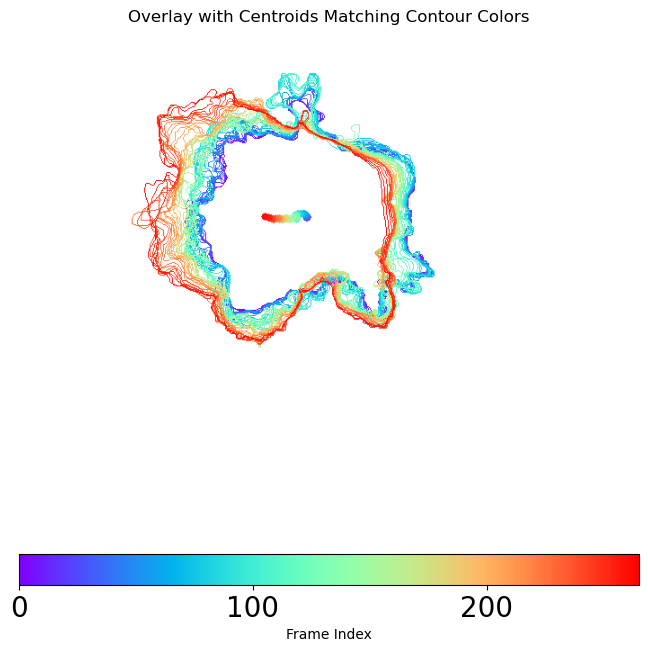

In [2]:
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import csv

# スタックTIFファイルを読み込む
stack_path = 'edge.tif'
stack = Image.open(stack_path)

# スタックの総フレーム数を取得
frames = []
try:
    while True:
        frames.append(stack.copy())
        stack.seek(len(frames))  # 次のフレームに移動
except EOFError:
    pass  # 最後のフレームに達したらループを終了

# 初期設定
width, height = frames[0].size
num_frames = len(frames)

# 出力画像を初期化（背景を白で初期化）
output_image = np.ones((height, width, 3), dtype=np.uint8) * 255  # 背景を白に設定

# レインボーカラーのカラーマップを取得（警告回避）
cmap = plt.colormaps['rainbow']

# 重心座標を格納するリスト
centroids = []

# フレームごとに処理
for i, frame in enumerate(frames):
    # グレースケールに変換
    frame_np = np.array(frame.convert('L'))

    # 二値化
    _, thresh = cv2.threshold(frame_np, 1, 255, cv2.THRESH_BINARY)

    # カラーマップから色を取得
    normalized_index = i / num_frames
    color = cmap(normalized_index)[:3]
    color = tuple(int(255 * c) for c in color)

    # 輪郭検出
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # 最大面積の輪郭を描画
    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        cv2.drawContours(output_image, [largest_contour], -1, color, 1)

        # 重心を計算
        M = cv2.moments(largest_contour)
        if M["m00"] != 0:
            cx = int(M["m10"] / M["m00"])
            cy = int(M["m01"] / M["m00"])
            centroids.append((cx, cy))
            cv2.circle(output_image, (cx, cy), 4, color, -1)

# CSVファイルに保存
output_csv_path = 'centroids.csv'
with open(output_csv_path, 'w', newline='') as csvfile:
    csvwriter = csv.writer(csvfile)
    csvwriter.writerow(['X', 'Y'])
    csvwriter.writerows(centroids)

# 結果表示（修正済）
fig, ax = plt.subplots(figsize=(8, 8))
ax.imshow(output_image)
ax.axis('off')

# カラーバーを追加（横向き・スケーリング付き）
norm = plt.cm.colors.Normalize(vmin=0, vmax=num_frames * 5)
sm = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])  # ダミー

cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', label='Frame Index')
cbar.ax.tick_params(labelsize=20)
cbar.ax.locator_params(nbins=5)

plt.title("Overlay with Centroids Matching Contour Colors")
plt.show()


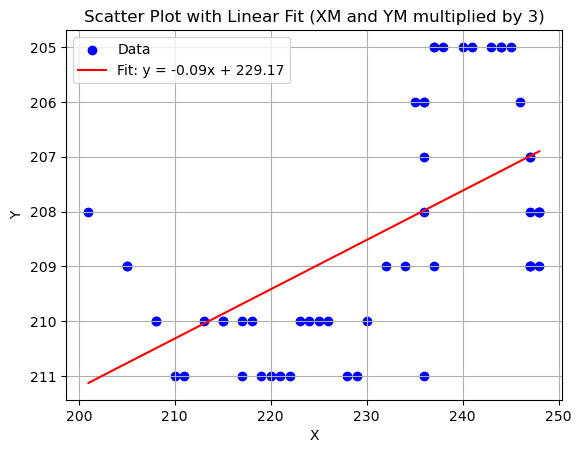

Fitted line equation: y = -0.09x + 229.17


In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.optimize import curve_fit

# CSVファイルからデータを読み込む
csv_filename = "./centroids.csv"  # 実際のファイルパスに置き換えてください
data = pd.read_csv(csv_filename)

# XM列とYM列のデータを取得
xm_data = data['X'] 
ym_data = data['Y'] 

# 散布図をプロット
plt.scatter(xm_data, ym_data, label='Data', color='blue')

# 一次関数のフィッティングを行うための関数を定義
def linear_func(x, a, b):
    return a * x + b

# フィッティングの初期値を設定
initial_guess = [1, 1]

# フィッティングを実行
params, covariance = curve_fit(linear_func, xm_data, ym_data, p0=initial_guess)

# フィッティング結果から抽出
a_fit, b_fit = params

# フィッティングした一次関数をプロット
x_fit = np.linspace(min(xm_data), max(xm_data), 100)
y_fit = linear_func(x_fit, a_fit, b_fit)
plt.plot(x_fit, y_fit, label=f'Fit: y = {a_fit:.2f}x + {b_fit:.2f}', color='red', linestyle='-')

# プロットの設定
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Scatter Plot with Linear Fit (XM and YM multiplied by 3)')
plt.legend()
plt.grid(True)

# 縦軸を上下反転
plt.gca().invert_yaxis()

# グラフを表示
plt.show()

# フィッティング結果を表示
print(f'Fitted line equation: y = {a_fit:.2f}x + {b_fit:.2f}')


Total number of images in the stack: 53


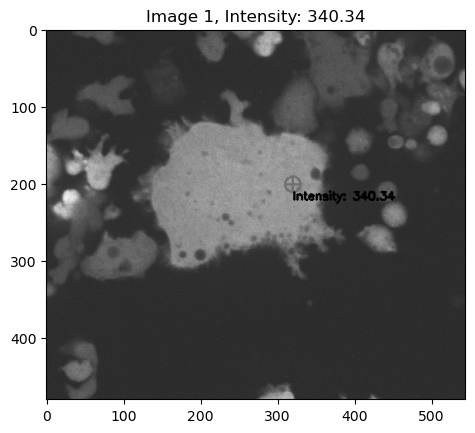

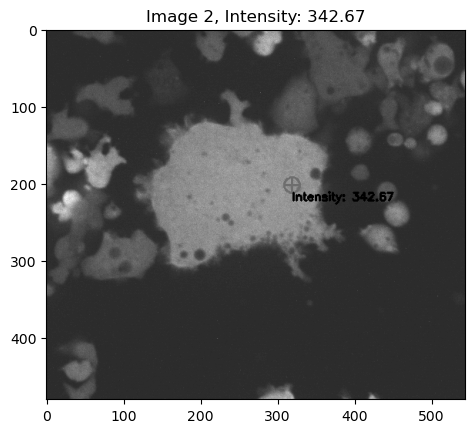

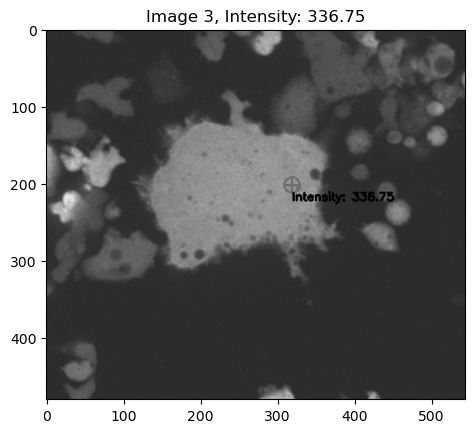

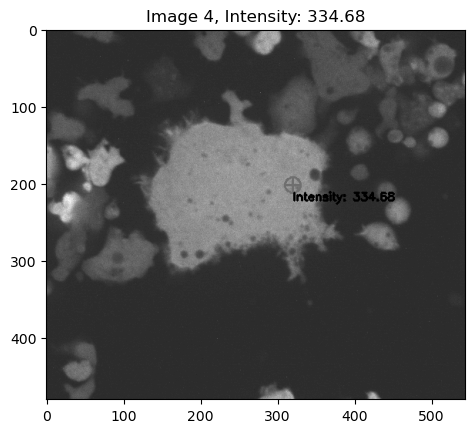

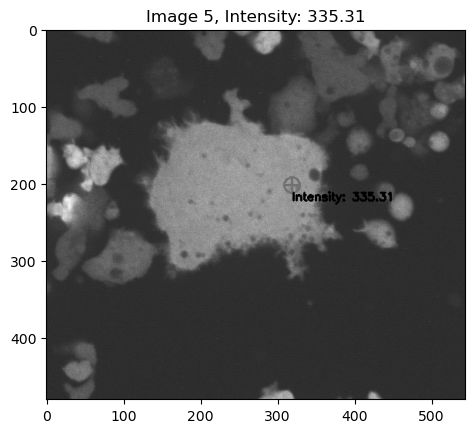

...

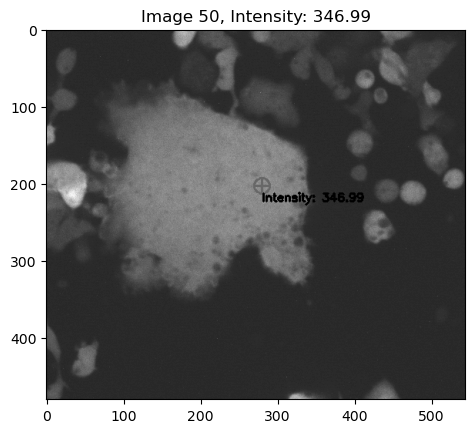

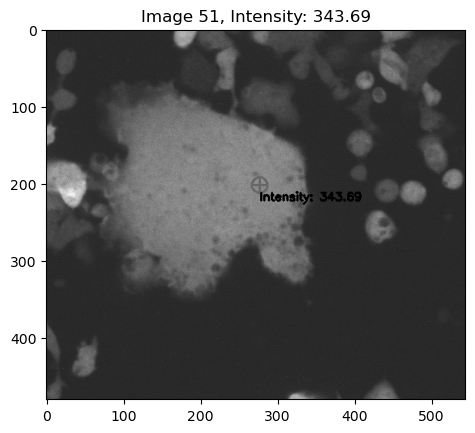

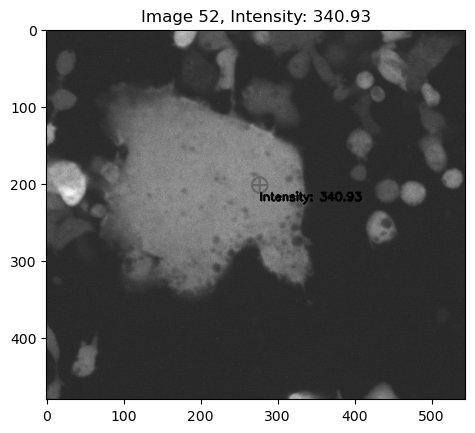

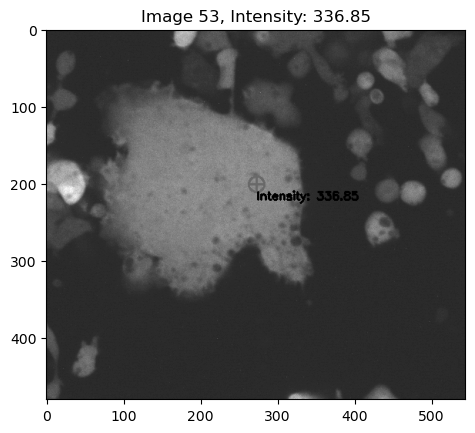

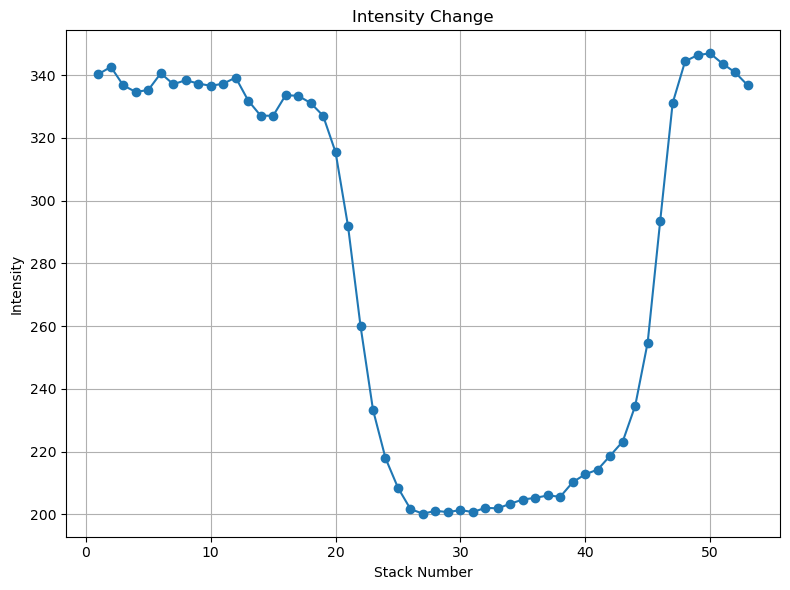

In [4]:
import tifffile
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import numpy as np

def read_tiff_stack(filename):
    try:
        with tifffile.TiffFile(filename) as tif:
            image_stack = tif.asarray()
            return image_stack
    except Exception as e:
        print(f"Error occurred while reading the TIFF stack: {e}")
        return None

def measure_intensity_change(stack, coordinates_df, radius, x_move, y_move):
    num_images = len(stack)
    intensities = []

    for i in range(num_images):
        image = stack[i]
        x, y = int(coordinates_df['X'][i]), int(coordinates_df['Y'][i])

        # 移動後の中心座標を計算
        x_center = int(x + x_move * 3.6364)
        y_center = int(y + y_move * 3.6364)

        # 円内のピクセルを取得
        masked_pixels = []
        for x_pixel in range(x_center - radius, x_center + radius + 1):
            for y_pixel in range(y_center - radius, y_center + radius + 1):
                if (x_pixel - x_center) ** 2 + (y_pixel - y_center) ** 2 <= radius ** 2:
                    masked_pixels.append(image[y_pixel, x_pixel])

        if len(masked_pixels) > 0:
            # 円内の平均輝度値を計算
            intensity = np.mean(masked_pixels)
        else:
            intensity = 0.0

        intensities.append(intensity)

        # 画像と測定個所を表示
        circle_image = image.copy()
        cv2.circle(circle_image, (x_center, y_center), radius, (255, 0, 0), 2)
        cv2.line(circle_image, (x_center - 10, y_center), (x_center + 10, y_center), (255, 0, 0), 2)
        cv2.line(circle_image, (x_center, y_center - 10), (x_center, y_center + 10), (255, 0, 0), 2)
        cv2.putText(circle_image, f"Intensity: {intensity:.2f}", (x_center, y_center + 20), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
        plt.imshow(circle_image, cmap='gray')
        plt.title(f"Image {i+1}, Intensity: {intensity:.2f}")
        plt.show()

    return intensities

def plot_intensity_change(intensities):
    num_images = len(intensities)

    # 輝度値の変化をグラフ化
    plt.figure(figsize=(8, 6))
    plt.plot(range(1, num_images + 1), intensities, marker='o')
    plt.xlabel("Stack Number")
    plt.ylabel("Intensity")
    plt.title("Intensity Change")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    tiff_filename = "./29_81_zoom.tif"
    coordinates_filename = "./centroids.csv"
    radius = 10  # 円の半径

    # 移動量を指定 (例: x_move = 20, y_move = x_move * -0.09)
    x_move = 20
    y_move = x_move * -0.09

    # 画像スタックを読み込む
    stack = read_tiff_stack(tiff_filename)

    if stack is not None:
        num_images = len(stack)
        print(f"Total number of images in the stack: {num_images}")

        # CSVファイルからXMとYMの列を読み込む
        coordinates_df = pd.read_csv(coordinates_filename)

        # 輝度値の測定と表示を行う
        intensities = measure_intensity_change(stack, coordinates_df, radius, x_move, y_move)

        # 輝度値の変化をグラフ化
        plot_intensity_change(intensities)

        # 輝度値をDataFrameに格納
        data = {'Stack Number': [i * 5 for i in range(1, num_images + 1)], 'Intensity': intensities}
        df = pd.DataFrame(data)

        # CSVファイルに保存
        df.to_csv('rear_intensity_data.csv', index=False)


Total number of images in the stack: 53


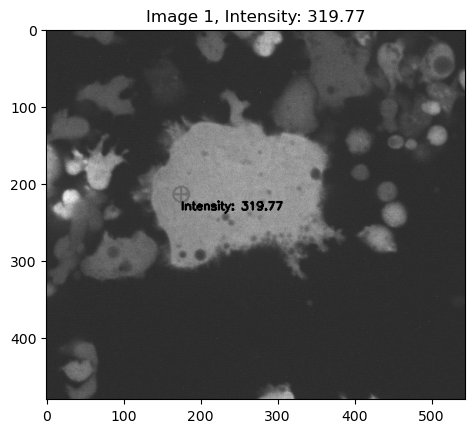

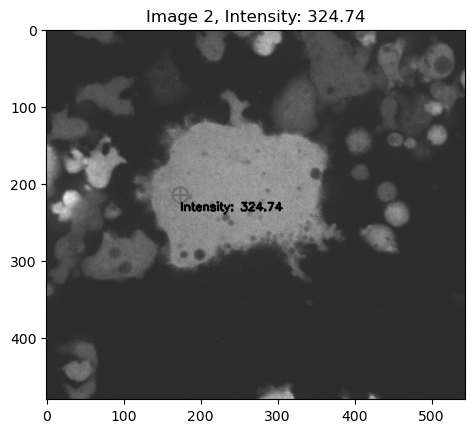

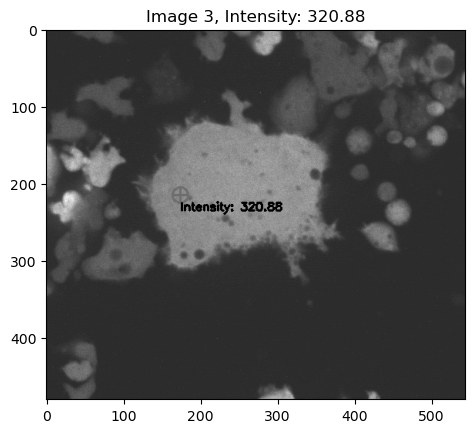

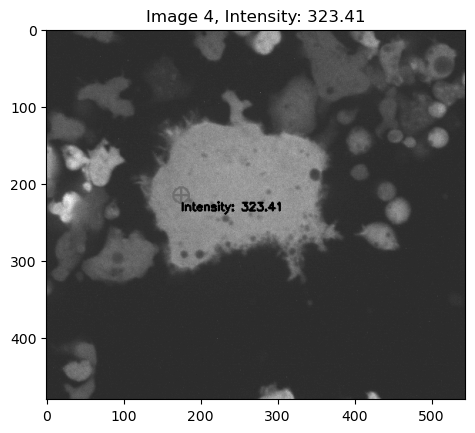

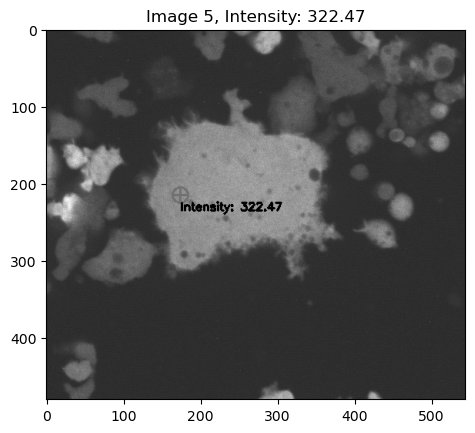

...

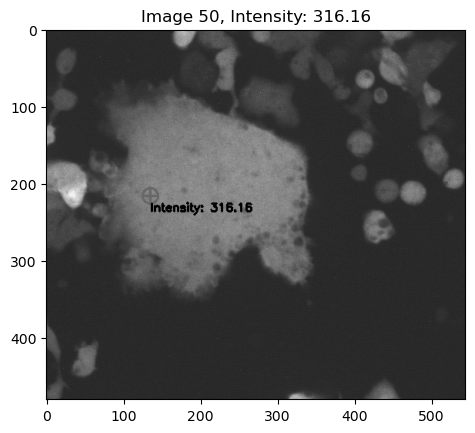

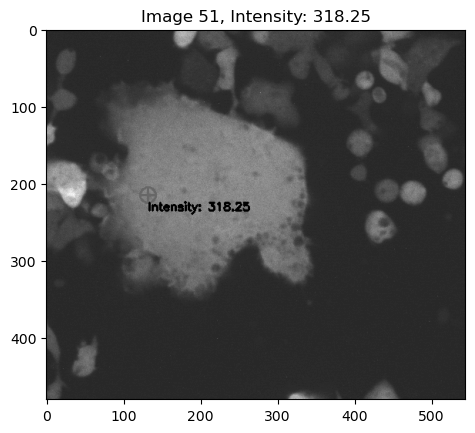

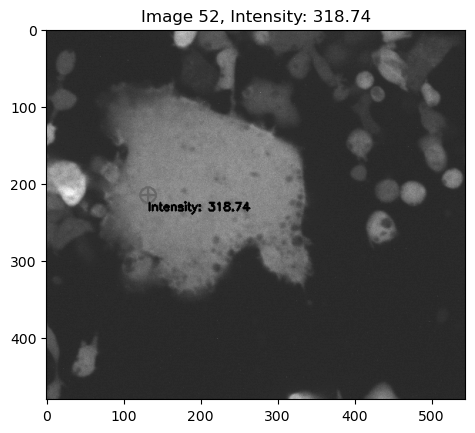

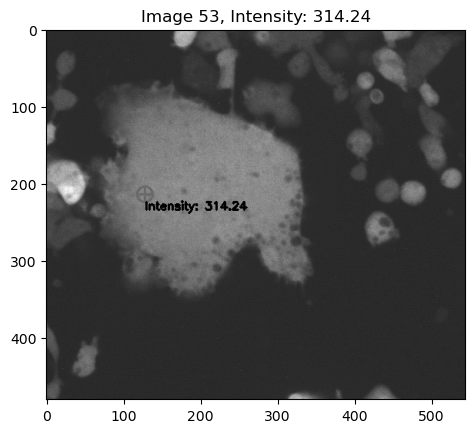

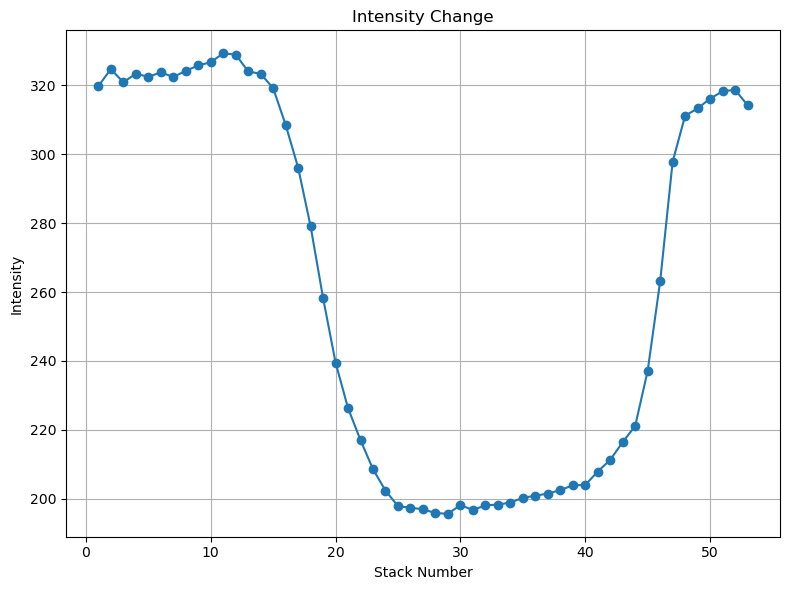

In [5]:
import tifffile
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import numpy as np

def read_tiff_stack(filename):
    try:
        with tifffile.TiffFile(filename) as tif:
            image_stack = tif.asarray()
            return image_stack
    except Exception as e:
        print(f"Error occurred while reading the TIFF stack: {e}")
        return None

def measure_intensity_change(stack, coordinates_df, radius, x_move, y_move):
    num_images = len(stack)
    intensities = []

    for i in range(num_images):
        image = stack[i]
        x, y = int(coordinates_df['X'][i]), int(coordinates_df['Y'][i])

        # 移動後の中心座標を計算
        x_center = int(x  + x_move * 3.6364)
        y_center = int(y  + y_move * 3.6364)

        # 円内のピクセルを取得
        masked_pixels = []
        for x_pixel in range(x_center - radius, x_center + radius + 1):
            for y_pixel in range(y_center - radius, y_center + radius + 1):
                if (x_pixel - x_center) ** 2 + (y_pixel - y_center) ** 2 <= radius ** 2:
                    masked_pixels.append(image[y_pixel, x_pixel])

        if len(masked_pixels) > 0:
            # 円内の平均輝度値を計算
            intensity = np.mean(masked_pixels)
        else:
            intensity = 0.0

        intensities.append(intensity)

        # 画像と測定個所を表示
        circle_image = image.copy()
        cv2.circle(circle_image, (x_center, y_center), radius, (255, 0, 0), 2)
        cv2.line(circle_image, (x_center - 10, y_center), (x_center + 10, y_center), (255, 0, 0), 2)
        cv2.line(circle_image, (x_center, y_center - 10), (x_center, y_center + 10), (255, 0, 0), 2)
        cv2.putText(circle_image, f"Intensity: {intensity:.2f}", (x_center, y_center + 20), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
        plt.imshow(circle_image, cmap='gray')
        plt.title(f"Image {i+1}, Intensity: {intensity:.2f}")
        plt.show()

    return intensities

def plot_intensity_change(intensities):
    num_images = len(intensities)

    # 輝度値の変化をグラフ化
    plt.figure(figsize=(8, 6))
    plt.plot(range(1, num_images + 1), intensities, marker='o')
    plt.xlabel("Stack Number")
    plt.ylabel("Intensity")
    plt.title("Intensity Change")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    tiff_filename = "./29_81_zoom.tif"
    coordinates_filename = "./centroids.csv"
    radius = 10  # 円の半径

    # 移動量を指定 (例: x_move = -20, y_move = x_move * -0.09)
    x_move = -20
    y_move = x_move * -0.09

    # 画像スタックを読み込む
    stack = read_tiff_stack(tiff_filename)

    if stack is not None:
        num_images = len(stack)
        print(f"Total number of images in the stack: {num_images}")

        # CSVファイルからXMとYMの列を読み込む
        coordinates_df = pd.read_csv(coordinates_filename)

        # 輝度値の測定と表示を行う
        intensities = measure_intensity_change(stack, coordinates_df, radius, x_move, y_move)

        # 輝度値の変化をグラフ化
        plot_intensity_change(intensities)

        # 輝度値をDataFrameに格納
        data = {'Stack Number': [i * 5 for i in range(1, num_images + 1)], 'Intensity': intensities}
        df = pd.DataFrame(data)

        # CSVファイルに保存
        df.to_csv('front_intensity_data.csv', index=False)


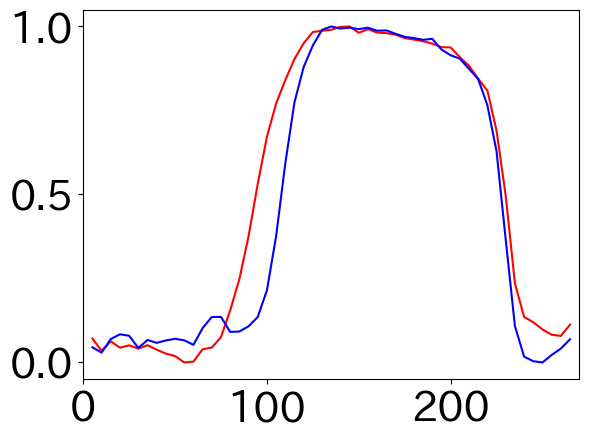

In [6]:
from matplotlib import pyplot as pyp
import pandas as pd
import matplotlib.pyplot as plt
import japanize_matplotlib

# 前面のデータを読み込み
path_csv = r"./front_intensity_data.csv"
df_csv = pd.read_csv(path_csv)
data_x = df_csv[df_csv.columns[0]]
data_y = df_csv[df_csv.columns[1]]

# 背面のデータを読み込み
path_csv = r"./rear_intensity_data.csv"
df_csv = pd.read_csv(path_csv)
data_y2 = df_csv[df_csv.columns[1]]

# 反転正規化用の関数
def reverse_normalize(data):
    max_val = data.max()  # 最大値を取得
    data = data - max_val  # 最大値を引いて反転
    min_val = data.min()  # 最小値を取得
    return data / min_val  # 最小値で割って正規化

# 反転正規化を適用
data_y = reverse_normalize(data_y.copy())
data_y2 = reverse_normalize(data_y2.copy())

# グラフのプロット
pyp.plot(data_x, data_y, label='Front', color="r")
pyp.plot(data_x, data_y2, label='Rear', color="b")

# x軸の範囲を設定
plt.xlim(0, 270)

# 軸の数字のフォントサイズを調整
plt.tick_params(axis='both', which='major', labelsize=30)

# ラベルとタイトルの設定（必要に応じてコメントアウトを外してください）
# pyp.title("一細胞内cAMP濃度勾配", {"fontsize": 15})
# pyp.xlabel("Time [sec]", {"fontsize": 15})
# pyp.ylabel("cAMP濃度", {"fontsize": 15})

# 凡例の表示
# pyp.legend()

# グラフを表示
pyp.show()


front:
a_slope= 0.1166112615064894
b_halftime 94.39349888280302
rear:
a_slope= 0.16749644332703414
b_halftime= 108.36558557561213


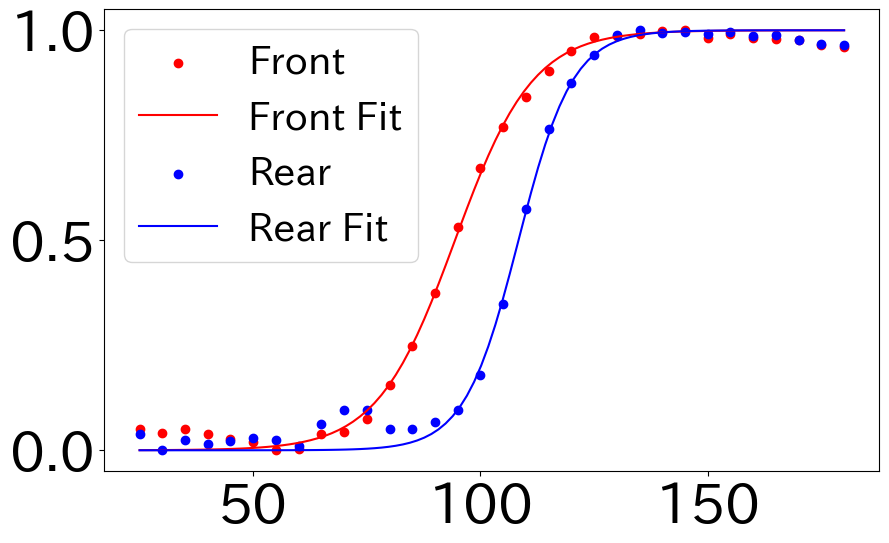

In [7]:
import numpy as np
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt
import pandas as pd

# シグモイド関数の定義
def sigmoid(x, a, b, c):
    return c / (1 + np.exp(-a * (x - b)))

# データ読み込み
path_csv1 = r"./front_intensity_data.csv"
path_csv2 = r"./rear_intensity_data.csv"

df_csv1 = pd.read_csv(path_csv1)
df_csv2 = pd.read_csv(path_csv2)  # 2つ目のCSVファイルを読み込む

# 指定した横軸の幅のデータを抽出
x_range_min = 25  # 横軸の最小値
x_range_max = 180  # 横軸の最大値
mask1 = (df_csv1[df_csv1.columns[0]] >= x_range_min) & (df_csv1[df_csv1.columns[0]] <= x_range_max)
mask2 = (df_csv2[df_csv2.columns[0]] >= x_range_min) & (df_csv2[df_csv2.columns[0]] <= x_range_max)
x_data1 = df_csv1.loc[mask1, df_csv1.columns[0]]
y_data1 = df_csv1.loc[mask1, df_csv1.columns[1]]
x_data2 = df_csv2.loc[mask2, df_csv2.columns[0]]
y_data2 = df_csv2.loc[mask2, df_csv2.columns[1]]

# 反転正規化
y_max1 = max(y_data1)
y_data1 = (y_data1 - y_max1)
y_min1 = min(y_data1)
y_data1 = y_data1 / y_min1
y_max2 = max(y_data2)
y_data2 = (y_data2 - y_max2)
y_min2 = min(y_data2)
y_data2 = y_data2 / y_min2

# cの値を固定
c_fixed = 1

# 初期推定値の設定 (aとbのみ)
initial_guess = [1, 150]  # a, b の初期値を設定

# シグモイド関数にフィッティング (c_fixedを渡す)
params1, params_covariance1 = curve_fit(lambda x, a, b: sigmoid(x, a, b, c_fixed), x_data1, y_data1, p0=initial_guess)
params2, params_covariance2 = curve_fit(lambda x, a, b: sigmoid(x, a, b, c_fixed), x_data2, y_data2, p0=initial_guess)

# フィッティング後のパラメータ
a_fit1, b_fit1 = params1
a_fit2, b_fit2 = params2

# フィッティング曲線の作成
x_fit = np.linspace(x_range_min, x_range_max, 100)
y_fit1 = sigmoid(x_fit, a_fit1, b_fit1, c_fixed)
y_fit2 = sigmoid(x_fit, a_fit2, b_fit2, c_fixed)

print("front:")
print("a_slope=", a_fit1)
print("b_halftime", b_fit1)

print("rear:")
print("a_slope=", a_fit2)
print("b_halftime=", b_fit2)

# グラフのプロット
plt.figure(figsize=(10, 6))
plt.scatter(x_data1, y_data1, label='Front', color='r')  # 赤色でプロット
plt.plot(x_fit, y_fit1, label='Front Fit', color='r')
plt.scatter(x_data2, y_data2, label='Rear', color='b')  # 青色でプロット
plt.plot(x_fit, y_fit2, label='Rear Fit', color='b')

# 軸のフォントサイズを設定
plt.tick_params(axis='both', labelsize=40)  # 軸数字のフォントサイズを指定（14に設定）

# ラベルと凡例
# plt.xlabel('Time [sec]', fontsize=16)  # フォントサイズ変更
# plt.ylabel('cAMP concentration', fontsize=16)
plt.legend(fontsize=28)  # 凡例のフォントサイズを変更

# グラフを表示
plt.show()


front:
a_slope= -0.18736184517285792
b_halftime 228.46055843046153
rear:
a_slope= -0.20363503370112654
b_halftime= 226.97806659287113


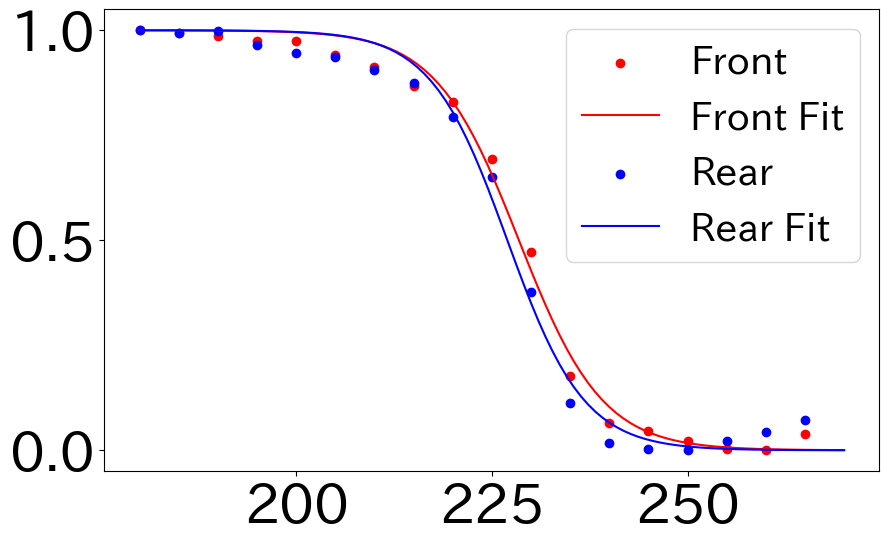

In [8]:
import numpy as np
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt
import pandas as pd

# シグモイド関数の定義
def sigmoid(x, a, b, c):
    return c / (1 + np.exp(-a * (x - b)))

# データ読み込み
path_csv1 = r"./front_intensity_data.csv"
path_csv2 = r"./rear_intensity_data.csv"

df_csv1 = pd.read_csv(path_csv1)
df_csv2 = pd.read_csv(path_csv2)  # 2つ目のCSVファイルを読み込む

# 指定した横軸の幅のデータを抽出
x_range_min = 180  # 横軸の最小値
x_range_max = 270  # 横軸の最大値
mask1 = (df_csv1[df_csv1.columns[0]] >= x_range_min) & (df_csv1[df_csv1.columns[0]] <= x_range_max)
mask2 = (df_csv2[df_csv2.columns[0]] >= x_range_min) & (df_csv2[df_csv2.columns[0]] <= x_range_max)
x_data1 = df_csv1.loc[mask1, df_csv1.columns[0]]
y_data1 = df_csv1.loc[mask1, df_csv1.columns[1]]
x_data2 = df_csv2.loc[mask2, df_csv2.columns[0]]
y_data2 = df_csv2.loc[mask2, df_csv2.columns[1]]

# 反転正規化
y_max1 = max(y_data1)
y_data1 = (y_data1 - y_max1)
y_min1 = min(y_data1)
y_data1 = y_data1 / y_min1
y_max2 = max(y_data2)
y_data2 = (y_data2 - y_max2)
y_min2 = min(y_data2)
y_data2 = y_data2 / y_min2

# cの値を固定
c_fixed = 1

# 初期推定値の設定 (aとbのみ)
initial_guess = [-1, 220]  # a, b の初期値を設定

# シグモイド関数にフィッティング (c_fixedを渡す)
params1, params_covariance1 = curve_fit(lambda x, a, b: sigmoid(x, a, b, c_fixed), x_data1, y_data1, p0=initial_guess)
params2, params_covariance2 = curve_fit(lambda x, a, b: sigmoid(x, a, b, c_fixed), x_data2, y_data2, p0=initial_guess)

# フィッティング後のパラメータ
a_fit1, b_fit1 = params1
a_fit2, b_fit2 = params2

# フィッティング曲線の作成
x_fit = np.linspace(x_range_min, x_range_max, 100)
y_fit1 = sigmoid(x_fit, a_fit1, b_fit1, c_fixed)
y_fit2 = sigmoid(x_fit, a_fit2, b_fit2, c_fixed)

print("front:")
print("a_slope=", a_fit1)
print("b_halftime", b_fit1)

print("rear:")
print("a_slope=", a_fit2)
print("b_halftime=", b_fit2)

# グラフのプロット
plt.figure(figsize=(10, 6))
plt.scatter(x_data1, y_data1, label='Front', color='r')  # 赤色でプロット
plt.plot(x_fit, y_fit1, label='Front Fit', color='r')
plt.scatter(x_data2, y_data2, label='Rear', color='b')  # 青色でプロット
plt.plot(x_fit, y_fit2, label='Rear Fit', color='b')

# 軸のフォントサイズを設定
plt.tick_params(axis='both', labelsize=40)  # 軸数字のフォントサイズを指定（14に設定）

# ラベルや凡例のフォントサイズを調整
# plt.xlabel('Time [sec]', fontsize=16)  # 必要に応じてコメント解除
# plt.ylabel('cAMP concentration', fontsize=16)  # 必要に応じてコメント解除
plt.legend(fontsize=28)  # 凡例のフォントサイズを変更

# グラフを表示
plt.show()


Total number of images in the stack: 53


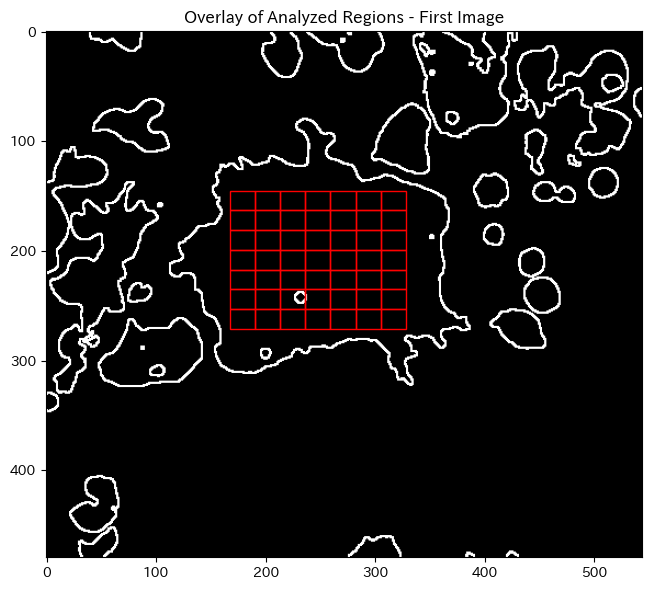

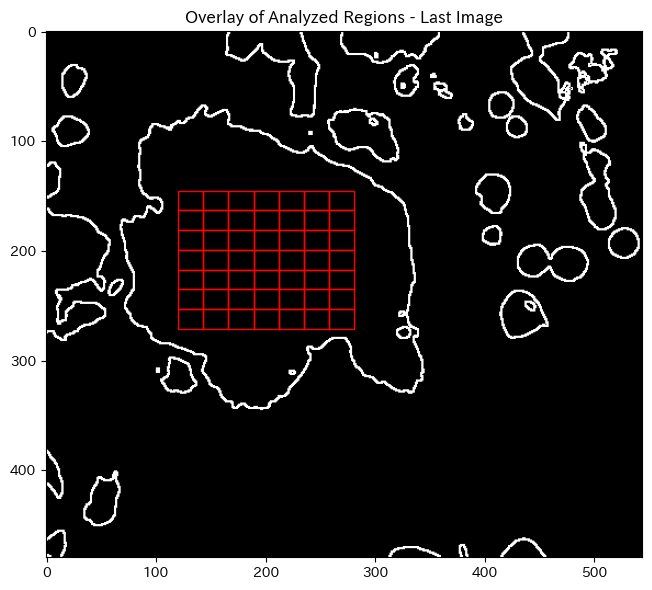

In [10]:
import tifffile
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import numpy as np

def read_tiff_stack(filename):
    try:
        with tifffile.TiffFile(filename) as tif:
            image_stack = tif.asarray()
            return image_stack
    except Exception as e:
        print(f"Error occurred while reading the TIFF stack: {e}")
        return None

if __name__ == "__main__":
    tiff_filename = "./edge.tif"
    coordinates_filename = "./centroids.csv"
    threshold = 0  # 閾値を設定
    divisions = 7  # 分割数を設定

    # 画像スタックを読み込む
    stack = read_tiff_stack(tiff_filename)

    if stack is not None:
        num_images = len(stack)
        print(f"Total number of images in the stack: {num_images}")

        # CSVファイルから座標を読み込む
        coordinates_df = pd.read_csv(coordinates_filename)

        # 各解析範囲の輝度値を格納するリスト
        all_intensities_lists = []

        for i in range(num_images):
            image = stack[i]

            x, y = int(coordinates_df.iloc[i, 0]), int(coordinates_df.iloc[i, 1])
            width = int(45 * 3.6364)  # 幅（= 約163）
            height = int(35 * 3.6364)  # 高さ（= 約127）

            intensities_list = []
            for row_div in range(divisions):
                for col_div in range(divisions):
                    dx = -width / 2 + (col_div + 0.5) * (width / divisions)
                    dy = height / 2 - (row_div + 0.5) * (height / divisions)
                    x_div = int(x + dx)
                    y_div = int(y + dy)

                    # 切り出し範囲を計算（安全確認付き）
                    y1 = max(0, y_div - height // (2 * divisions))
                    y2 = min(image.shape[0], y_div + height // (2 * divisions))
                    x1 = max(0, x_div - width // (2 * divisions))
                    x2 = min(image.shape[1], x_div + width // (2 * divisions))

                    intensities_in_div = image[y1:y2, x1:x2]
                    mask = intensities_in_div > threshold
                    masked_intensities = intensities_in_div[mask]

                    if masked_intensities.size > 0:
                        average_intensity = masked_intensities.mean()
                    else:
                        average_intensity = 0  # または np.nan にしても良い

                    intensities_list.append(average_intensity)

            all_intensities_lists.append(intensities_list)

        # 解析領域を最初の画像に重ねて表示
        plt.figure(figsize=(8, 6))
        plt.imshow(stack[0], cmap='gray')

        x_first_rect = int(coordinates_df.iloc[0, 0]) - width // 2
        y_first_rect = int(coordinates_df.iloc[0, 1]) - height // 2

        for region_num in range(divisions * divisions):
            x_rect = x_first_rect + (region_num % divisions) * (width // divisions)
            y_rect = y_first_rect + (region_num // divisions) * (height // divisions)
            rect = Rectangle((x_rect, y_rect), width // divisions, height // divisions, edgecolor='r', facecolor='none')
            plt.gca().add_patch(rect)

        plt.title("Overlay of Analyzed Regions - First Image")
        plt.tight_layout()
        plt.show()

        # 最後の画像に対しても同様に表示
        plt.figure(figsize=(8, 6))
        plt.imshow(stack[-1], cmap='gray')

        x_last_rect = int(coordinates_df.iloc[-1, 0]) - width // 2
        y_last_rect = int(coordinates_df.iloc[-1, 1]) - height // 2

        for region_num in range(divisions * divisions):
            x_rect = x_last_rect + (region_num % divisions) * (width // divisions)
            y_rect = y_last_rect + (region_num // divisions) * (height // divisions)
            rect = Rectangle((x_rect, y_rect), width // divisions, height // divisions, edgecolor='r', facecolor='none')
            plt.gca().add_patch(rect)

        plt.title("Overlay of Analyzed Regions - Last Image")
        plt.tight_layout()
        plt.show()


Total number of images in the stack: 53
Original CSV data saved to ./output_data\intensity_data_original7.csv


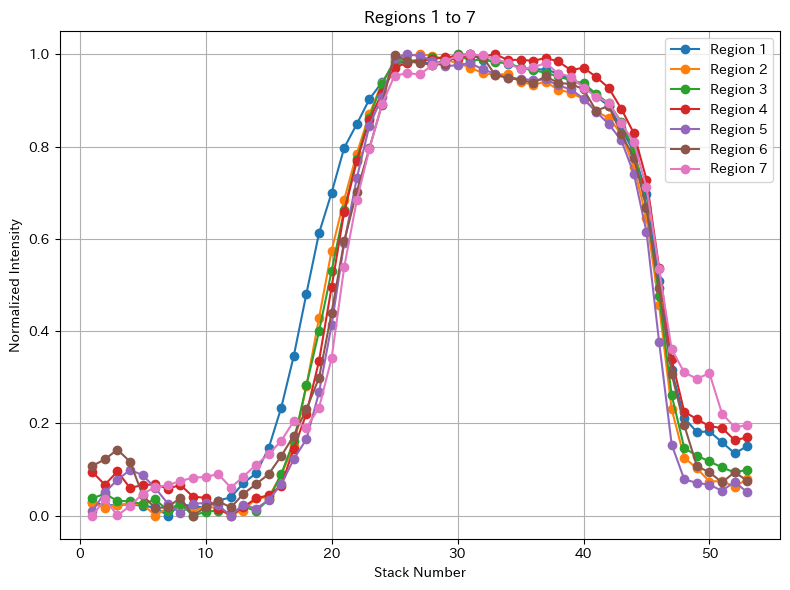

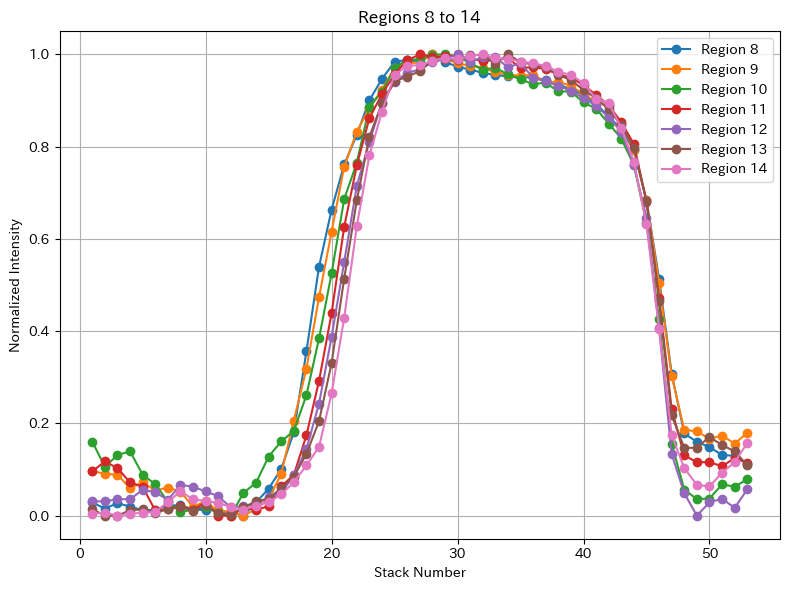

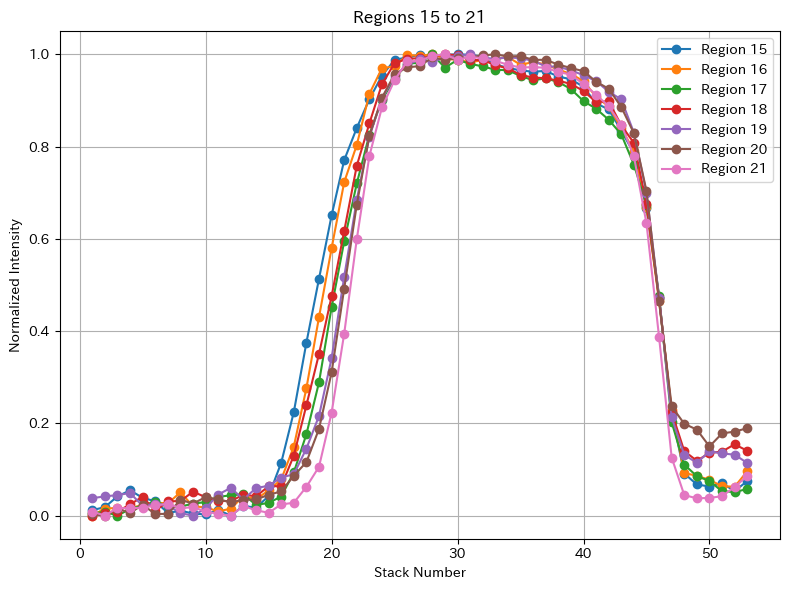

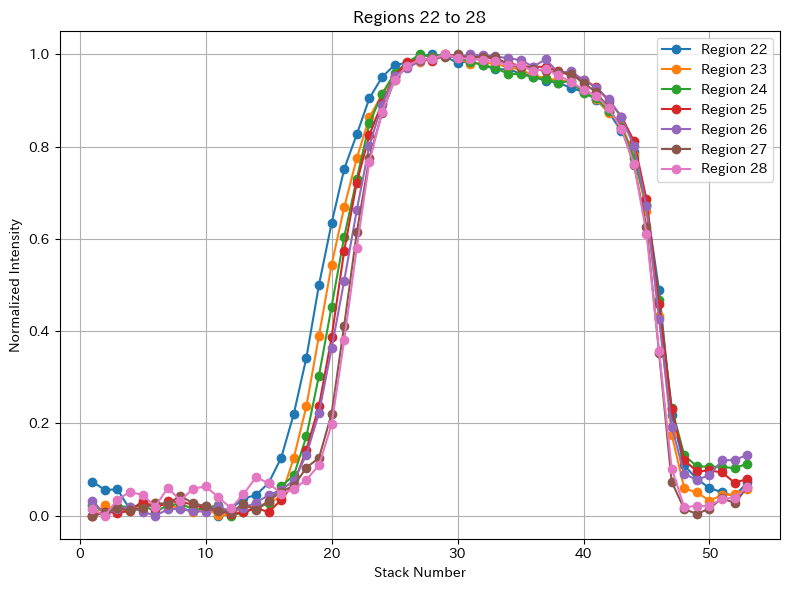

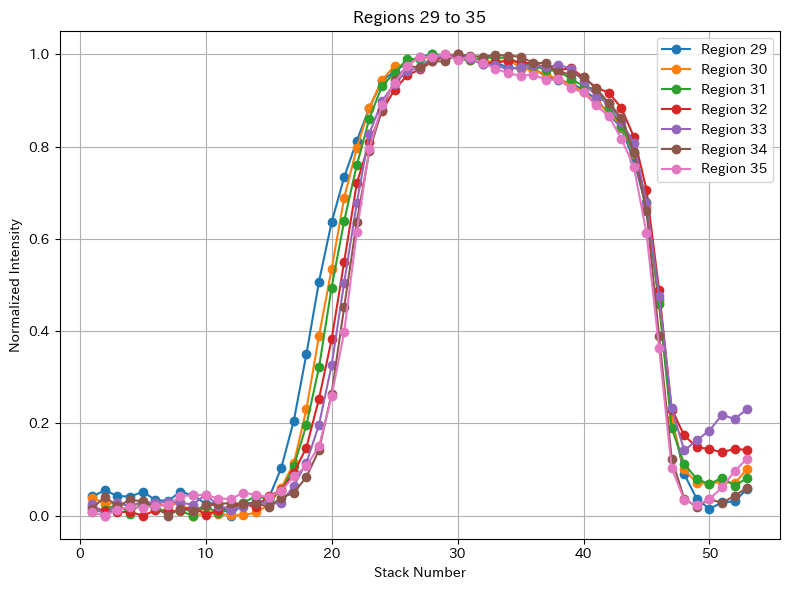

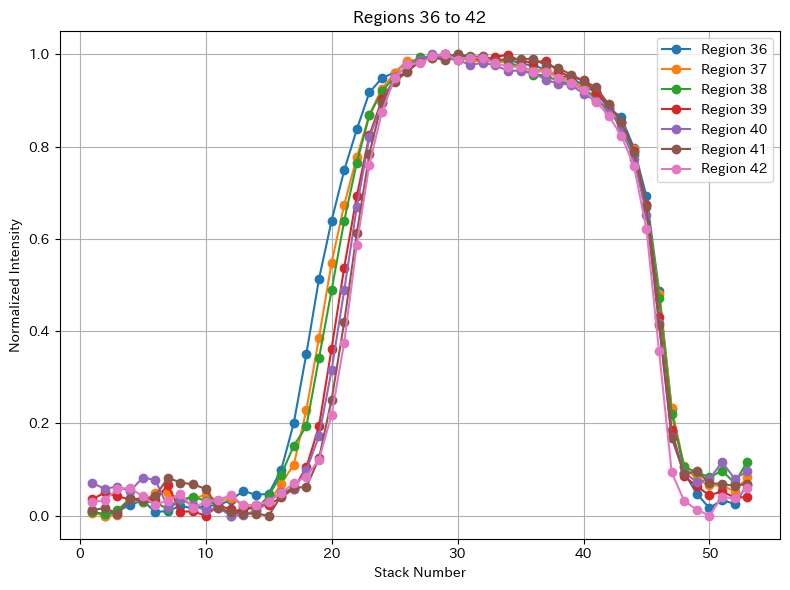

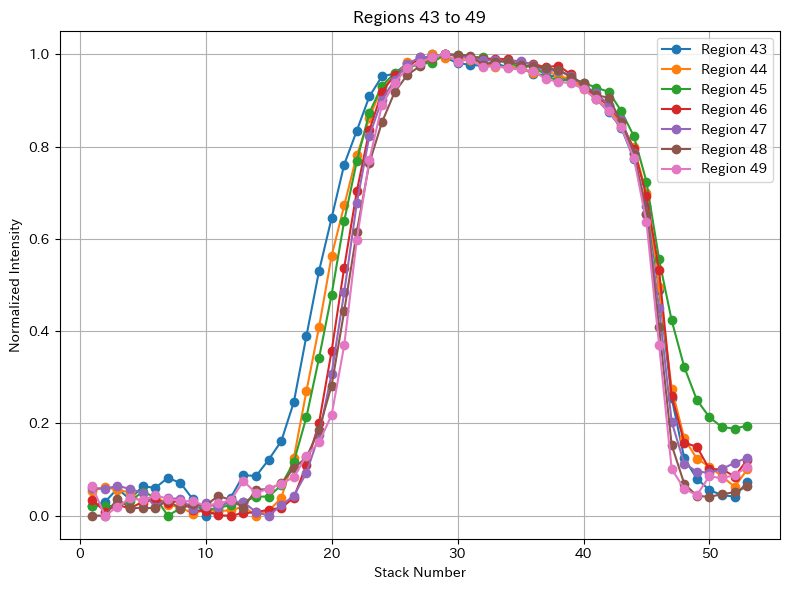

In [12]:
import os
import tifffile
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import numpy as np

def read_tiff_stack(filename):
    try:
        with tifffile.TiffFile(filename) as tif:
            image_stack = tif.asarray()
            return image_stack
    except Exception as e:
        print(f"Error occurred while reading the TIFF stack: {e}")
        return None

if __name__ == "__main__":
    tiff_filename = "./29_81_zoom.tif"
    coordinates_filename = "./centroids.csv"
    threshold = 0  # 閾値を設定
    divisions = 7  # 分割数を設定
    output_folder = "./output_data"  # 保存先フォルダを指定

    # 画像スタックを読み込む
    stack = read_tiff_stack(tiff_filename)

    if stack is not None:
        num_images = len(stack)
        print(f"Total number of images in the stack: {num_images}")

        # CSVファイルから座標を読み込む
        coordinates_df = pd.read_csv(coordinates_filename)

        # 各解析範囲の輝度値を格納するリスト
        all_intensities_lists = []

        for i in range(num_images):
            image = stack[i]

            x, y = int(coordinates_df.iloc[i, 0]), int(coordinates_df.iloc[i, 1])
            width = int(45 * 3.6364)  # 幅
            height = int(35 * 3.6364)  # 高さ
            
            intensities_list = []
            for row_div in range(divisions):
                for col_div in range(divisions):
                    dx = -width / 2 + (col_div + 0.5) * (width / divisions)
                    dy = height / 2 - (row_div + 0.5) * (height / divisions)
                    x_div = int(x + dx)
                    y_div = int(y + dy)
                    
                    if (0 <= y_div < image.shape[0]) and (0 <= x_div < image.shape[1]):
                        intensities_in_div = image[y_div - height // (2 * divisions): y_div + height // (2 * divisions),
                                                   x_div - width // (2 * divisions): x_div + width // (2 * divisions)]
                        
                        mask = intensities_in_div > threshold
                        masked_intensities = intensities_in_div[mask]
                        average_intensity = 0 if len(masked_intensities) == 0 else masked_intensities.mean()
                        intensities_list.append(average_intensity)
                    else:
                        intensities_list.append(0)  # 平均値を計算できない場合は0を追加
            
            all_intensities_lists.append(intensities_list)

        # 各解析範囲ごとに5枚ずつグラフを重ねて表示
        data_for_csv = []  # CSVファイルに書き込むデータを格納するリスト

        for start_region in range(0, divisions * divisions, divisions):
            region_data = []
            for region_num in range(start_region, start_region + divisions):
                intensities = [intensities[region_num] for intensities in all_intensities_lists]
                region_data.append(intensities)

            data_for_csv.append(region_data)

        # CSVファイルに書き込む
        df = pd.DataFrame(data_for_csv, columns=[f"Region_{region_num + 1}" for region_num in range(divisions)])
        output_filename = os.path.join(output_folder, "intensity_data_original7.csv")  # 出力ファイルパスを生成
        df.to_csv(output_filename, index=False)

        print(f"Original CSV data saved to {output_filename}")

        # グラフの表示部分（正規化）
        for start_region in range(0, divisions * divisions, divisions):
            plt.figure(figsize=(8, 6))
            for region_num in range(start_region, start_region + divisions):
                intensities = [intensities[region_num] for intensities in all_intensities_lists]

                # 輝度値を反転、正規化
                intensities = np.array(intensities)
                if np.any(intensities):  # intensitiesに0以外の値が含まれる場合のみ正規化
                    intensities = intensities * -1
                    normalized_intensities = (intensities - np.min(intensities)) / (np.max(intensities) - np.min(intensities))
                else:
                    normalized_intensities = intensities  # すべての値が0の場合はそのまま

                plt.plot(range(1, num_images + 1), normalized_intensities, marker='o', label=f"Region {region_num + 1}")

                
            plt.xlabel("Stack Number")
            plt.ylabel("Normalized Intensity")
            plt.title(f"Regions {start_region + 1} to {start_region + divisions}")
            plt.legend()
            plt.grid(True)
            plt.tight_layout()
            plt.show()


Fitted sigmoid parameters for Region 1, Image 1: [ 0.10014127 91.32682598]


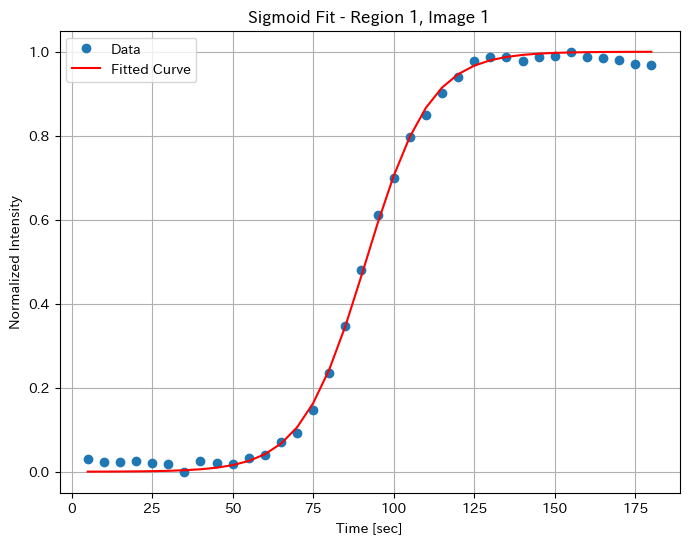

Fitted sigmoid parameters for Region 1, Image 2: [ 0.12642575 95.24373235]


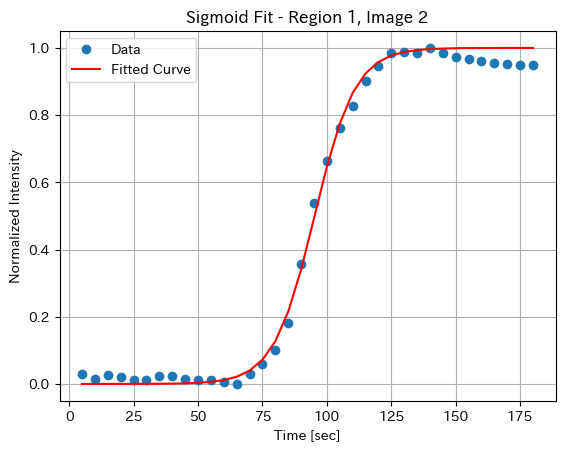

Fitted sigmoid parameters for Region 1, Image 3: [ 0.12462121 95.04658448]


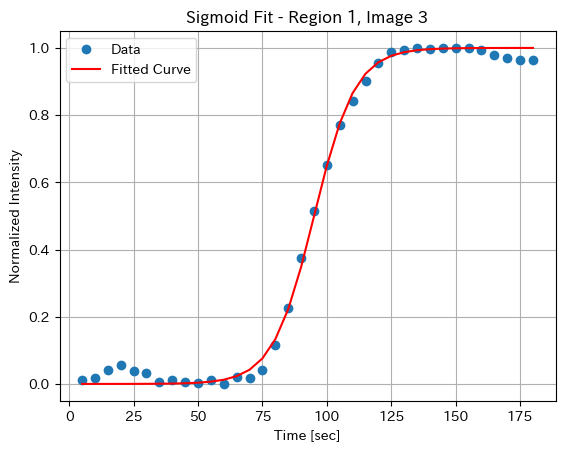

Fitted sigmoid parameters for Region 1, Image 4: [ 0.11791826 95.53407171]


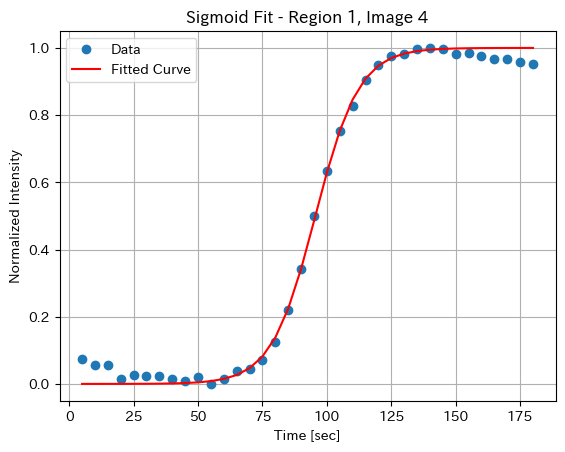

Fitted sigmoid parameters for Region 1, Image 5: [ 0.11833259 95.90554392]


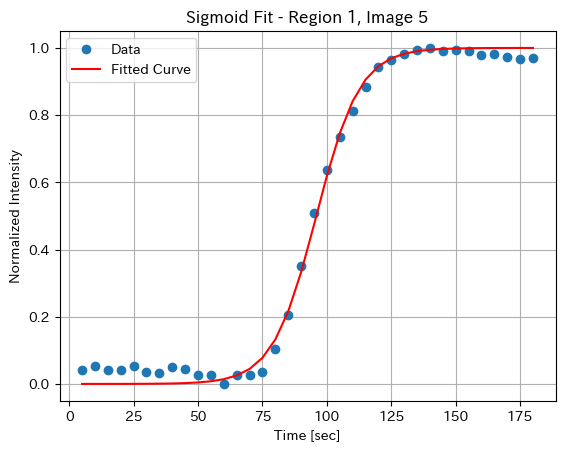

Fitted sigmoid parameters for Region 1, Image 6: [ 0.12208715 95.5161222 ]


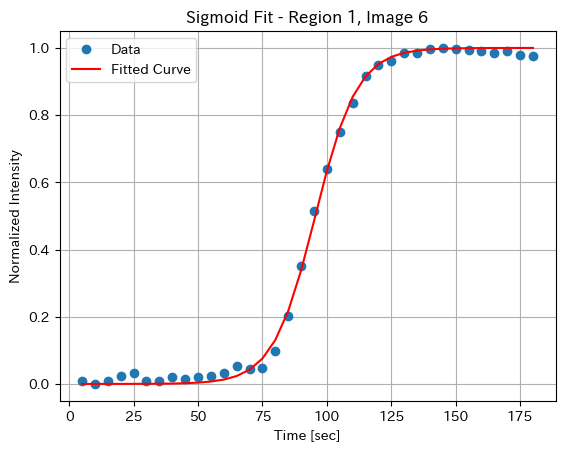

Fitted sigmoid parameters for Region 1, Image 7: [ 0.10528643 94.27524427]


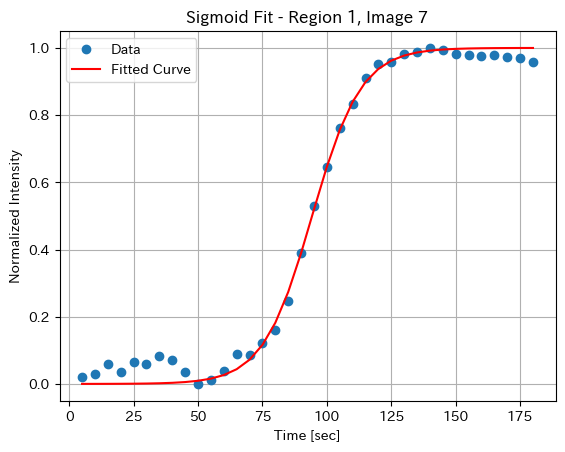

Fitted sigmoid parameters for Region 2, Image 1: [ 0.12093203 98.10411177]


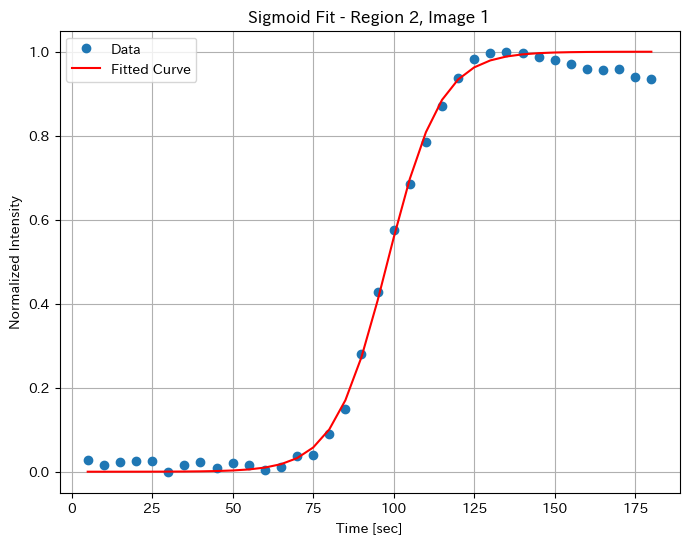

Fitted sigmoid parameters for Region 2, Image 2: [ 0.12376897 96.38113834]


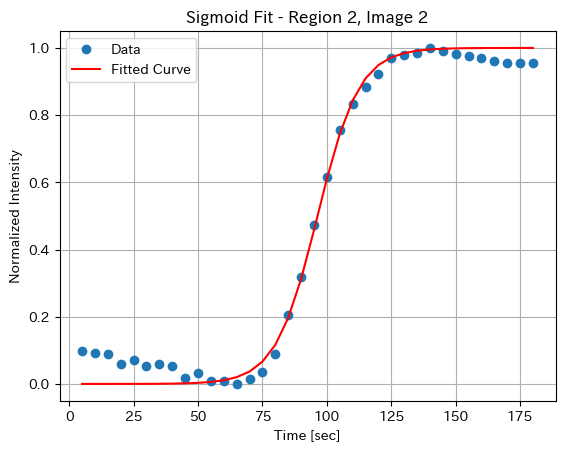

Fitted sigmoid parameters for Region 2, Image 3: [ 0.12933672 97.57632516]


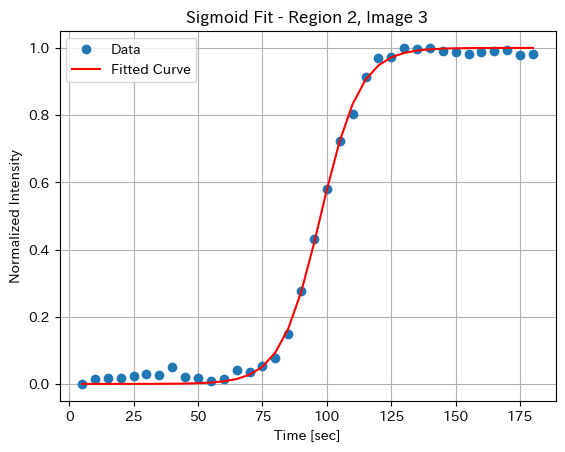

Fitted sigmoid parameters for Region 2, Image 4: [ 0.1249658 99.3627106]


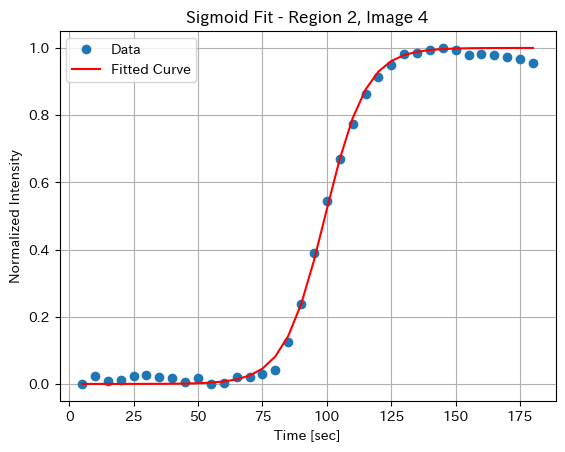

Fitted sigmoid parameters for Region 2, Image 5: [ 0.13428494 99.07967761]


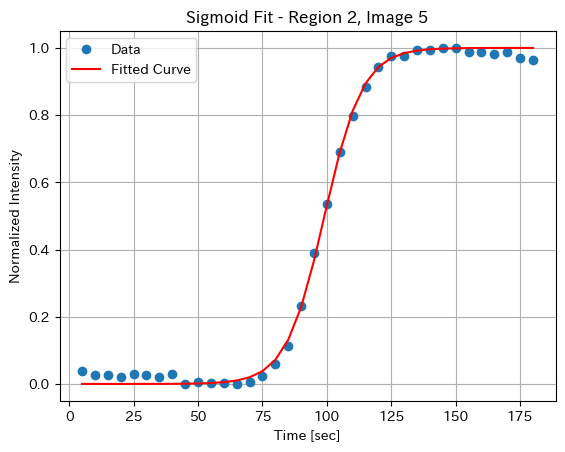

Fitted sigmoid parameters for Region 2, Image 6: [ 0.12694022 99.27924356]


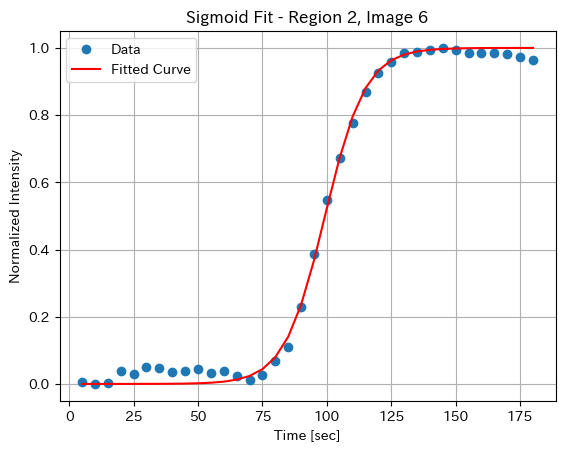

Fitted sigmoid parameters for Region 2, Image 7: [ 0.12560631 98.86932487]


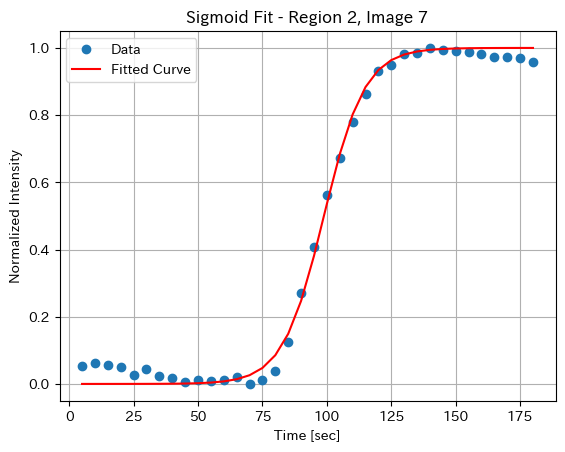

Fitted sigmoid parameters for Region 3, Image 1: [ 0.11829339 98.85621158]


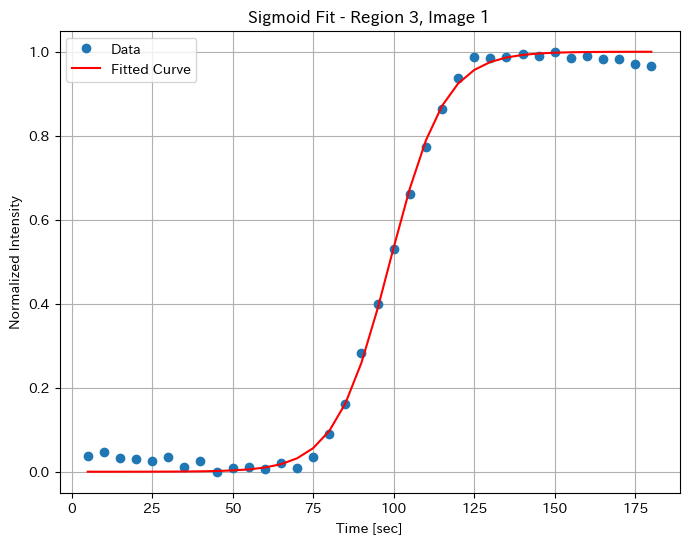

Fitted sigmoid parameters for Region 3, Image 2: [ 0.10710456 98.39337398]


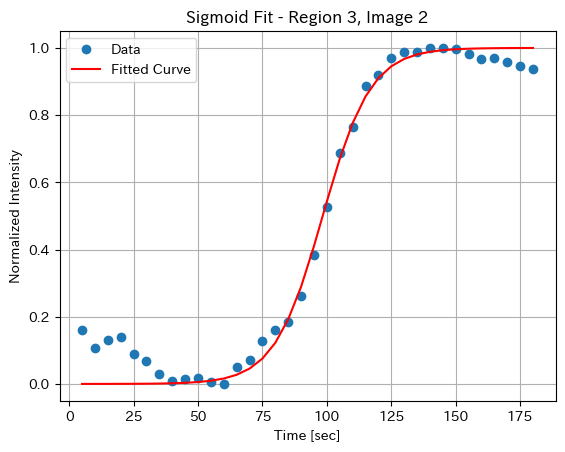

Fitted sigmoid parameters for Region 3, Image 3: [  0.12442808 102.09924656]


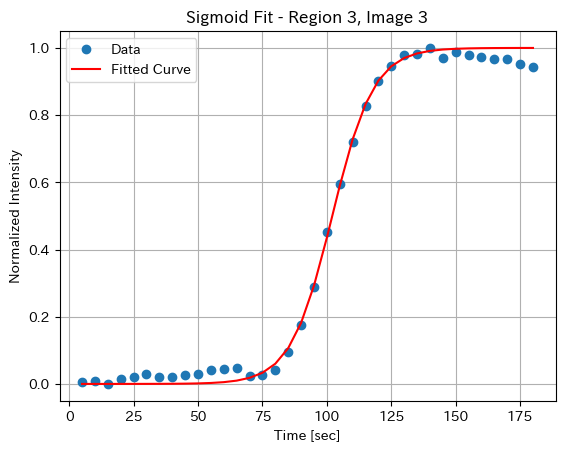

Fitted sigmoid parameters for Region 3, Image 4: [  0.12985033 101.72789426]


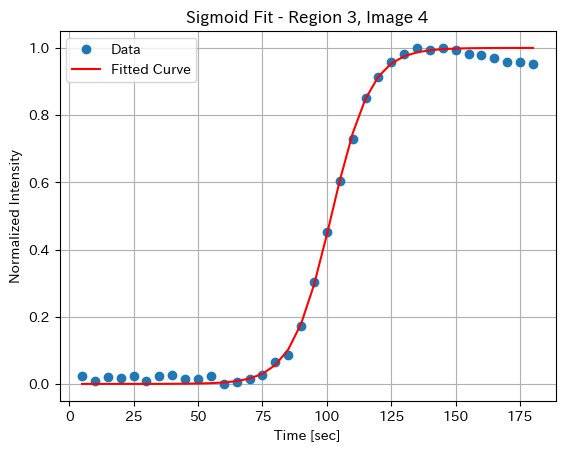

Fitted sigmoid parameters for Region 3, Image 5: [  0.13009585 100.64452139]


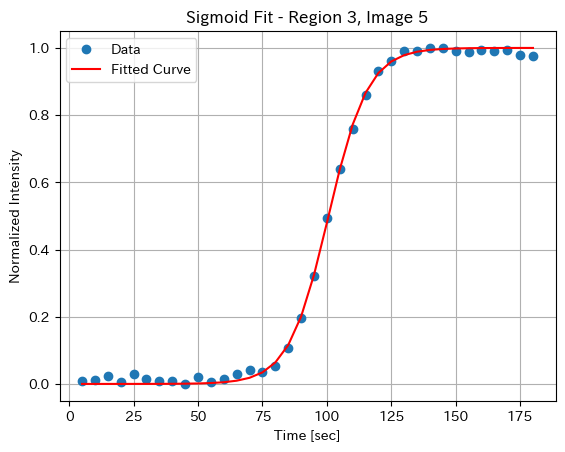

Fitted sigmoid parameters for Region 3, Image 6: [  0.12309166 100.34913352]


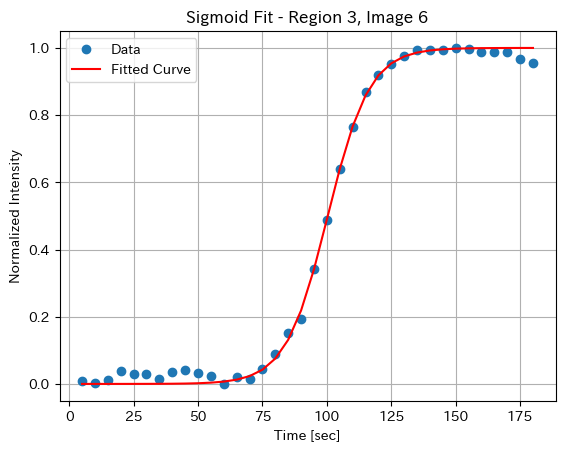

Fitted sigmoid parameters for Region 3, Image 7: [  0.12606173 100.41306294]


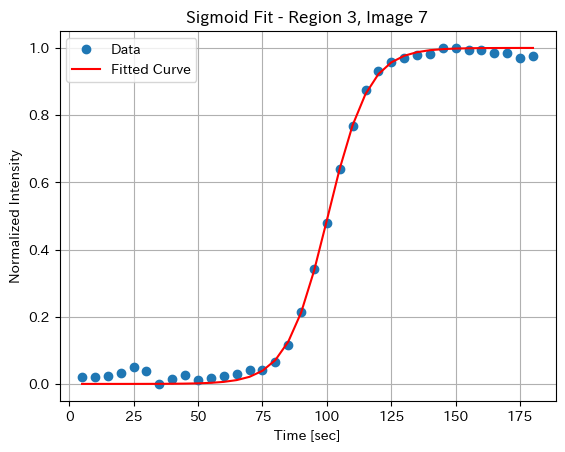

Fitted sigmoid parameters for Region 4, Image 1: [  0.12337036 100.12812798]


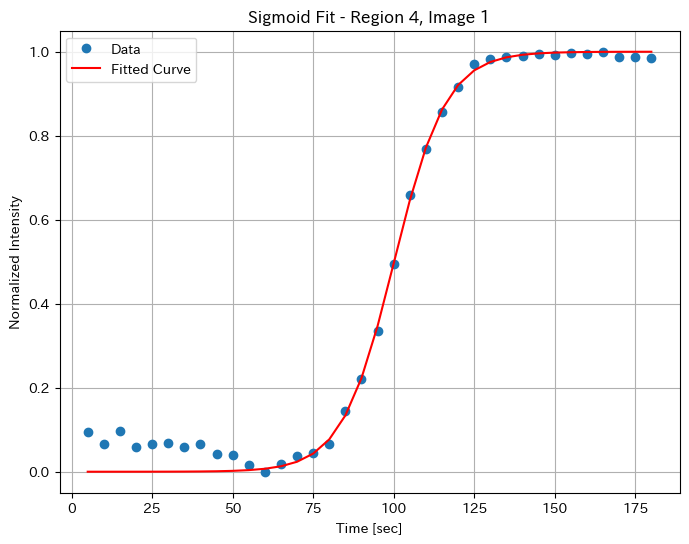

Fitted sigmoid parameters for Region 4, Image 2: [  0.13566729 101.54484044]


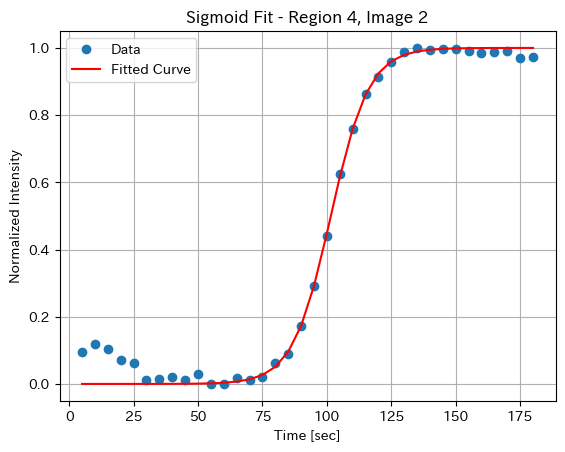

Fitted sigmoid parameters for Region 4, Image 3: [  0.11953719 100.37149632]


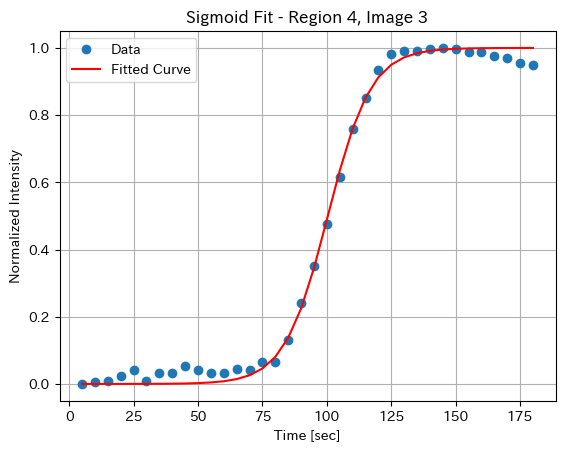

Fitted sigmoid parameters for Region 4, Image 4: [  0.13767804 103.24061371]


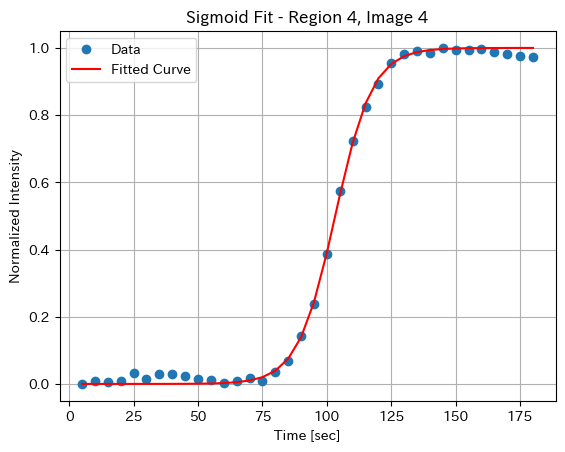

Fitted sigmoid parameters for Region 4, Image 5: [  0.12426213 103.45160755]


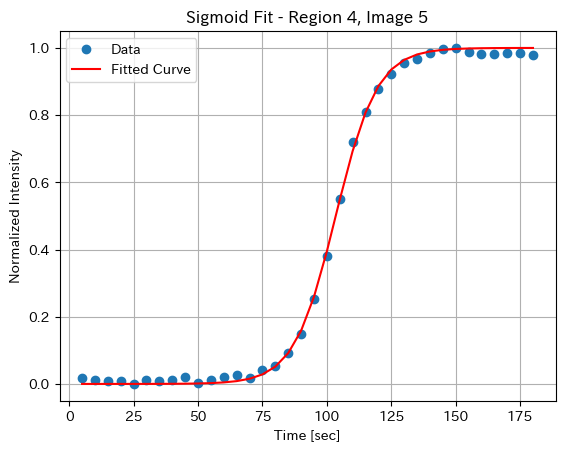

Fitted sigmoid parameters for Region 4, Image 6: [  0.14295185 104.22780243]


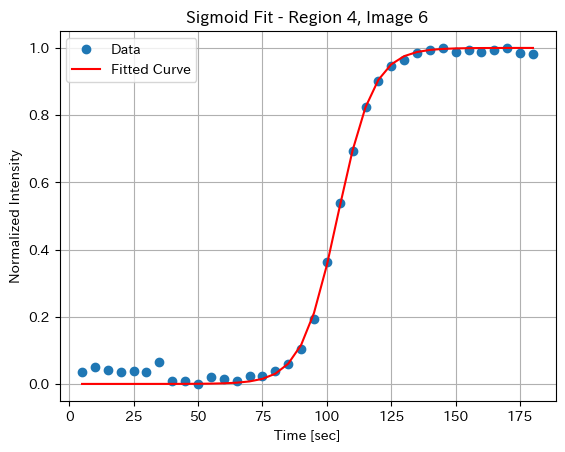

Fitted sigmoid parameters for Region 4, Image 7: [  0.15028442 104.0995206 ]


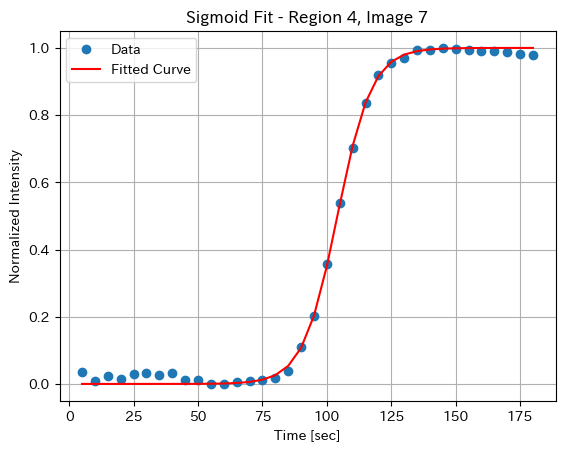

Fitted sigmoid parameters for Region 5, Image 1: [  0.13132479 102.24407378]


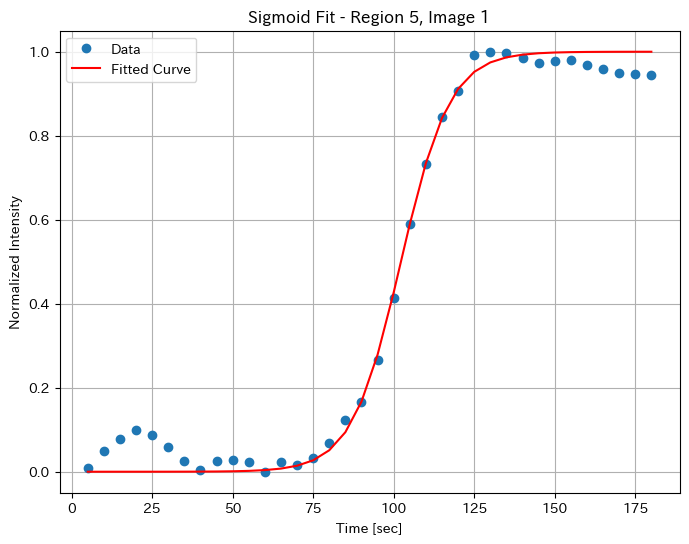

Fitted sigmoid parameters for Region 5, Image 2: [  0.13362905 103.86193848]


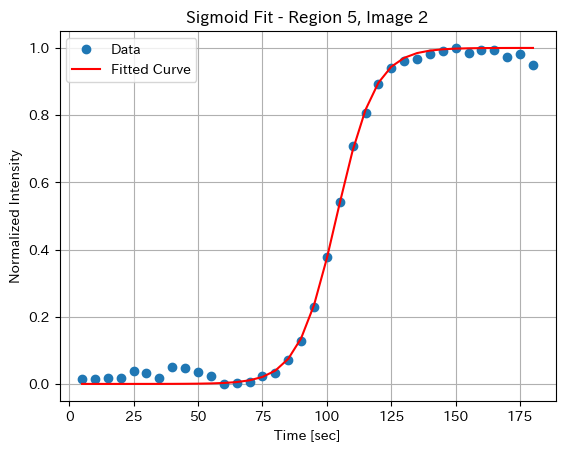

Fitted sigmoid parameters for Region 5, Image 3: [  0.13027275 104.14851361]


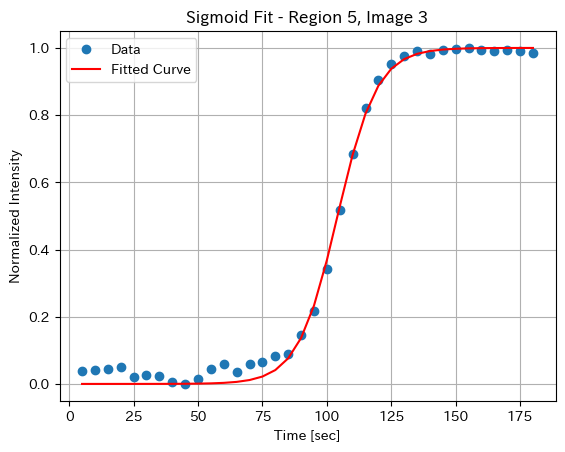

Fitted sigmoid parameters for Region 5, Image 4: [  0.12972161 104.44775044]


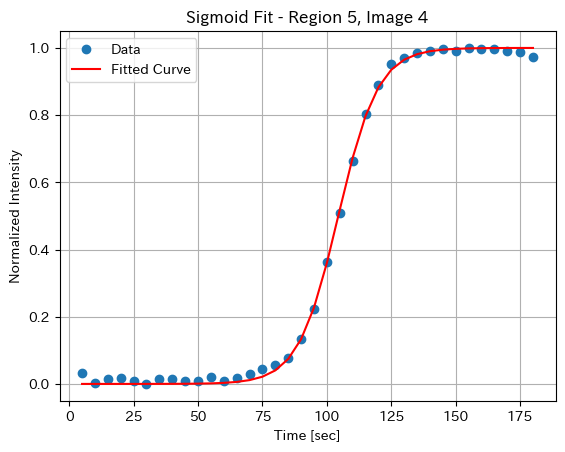

Fitted sigmoid parameters for Region 5, Image 5: [  0.14136482 104.77599449]


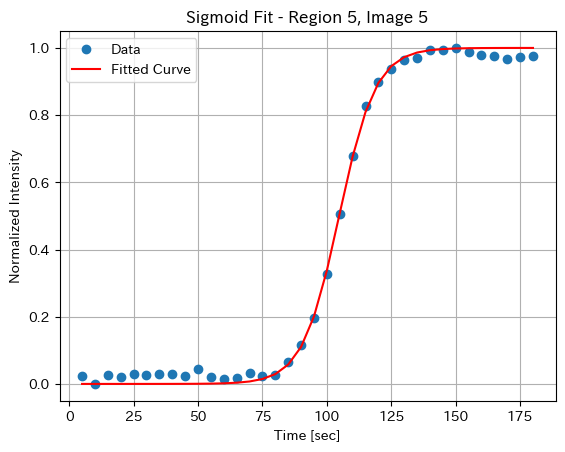

Fitted sigmoid parameters for Region 5, Image 6: [  0.14661152 105.20394061]


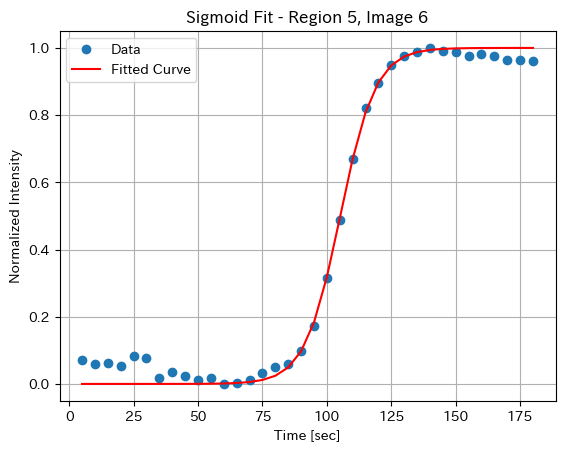

Fitted sigmoid parameters for Region 5, Image 7: [  0.15242173 105.25491277]


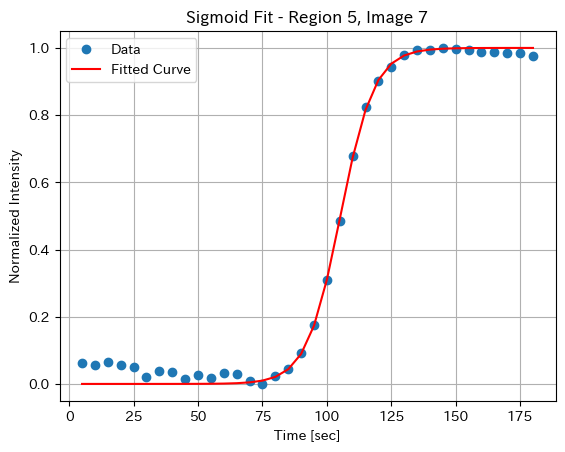

Fitted sigmoid parameters for Region 6, Image 1: [  0.10479977 101.39261094]


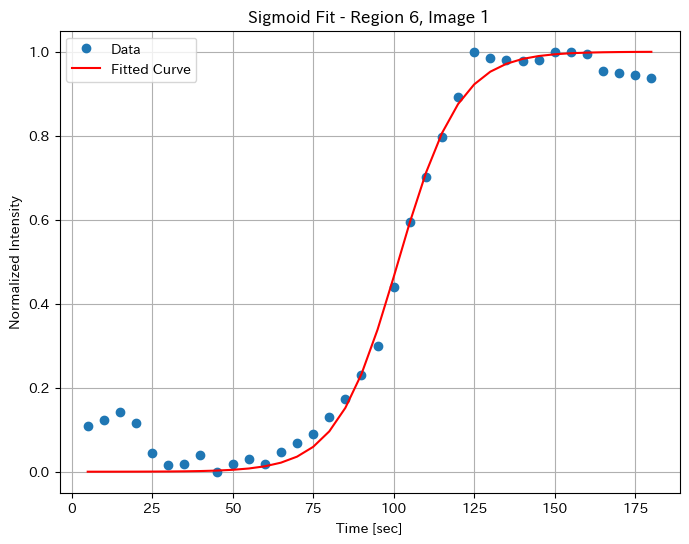

Fitted sigmoid parameters for Region 6, Image 2: [  0.13360928 104.52306651]


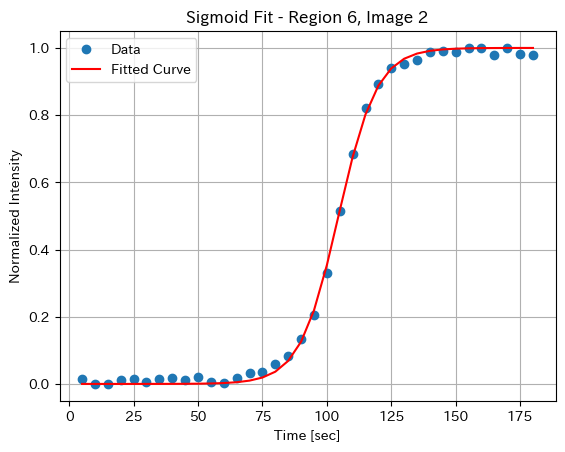

Fitted sigmoid parameters for Region 6, Image 3: [  0.14164798 104.93297961]


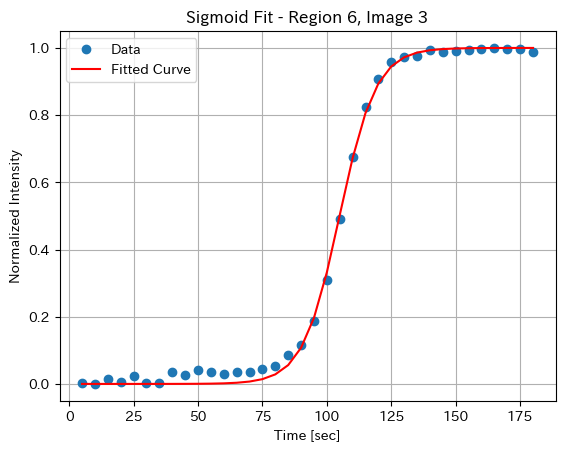

Fitted sigmoid parameters for Region 6, Image 4: [  0.15174132 107.19097369]


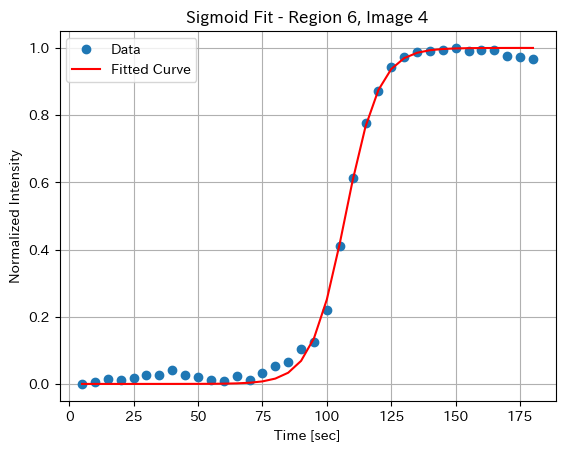

Fitted sigmoid parameters for Region 6, Image 5: [  0.14975194 106.38946756]


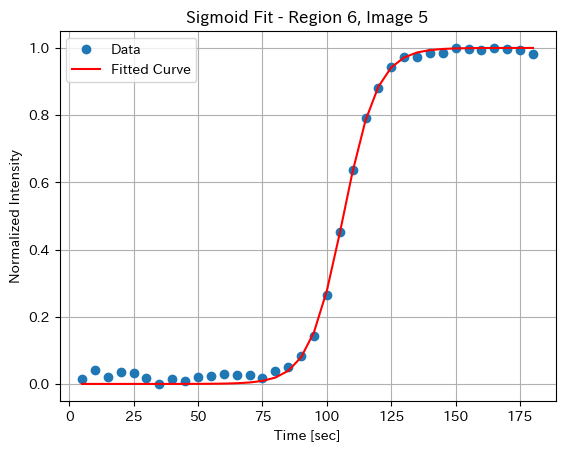

Fitted sigmoid parameters for Region 6, Image 6: [  0.15615638 106.98036232]


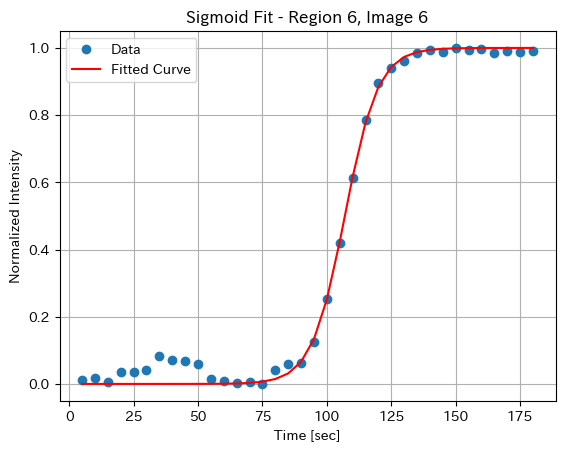

Fitted sigmoid parameters for Region 6, Image 7: [  0.12353753 106.32388082]


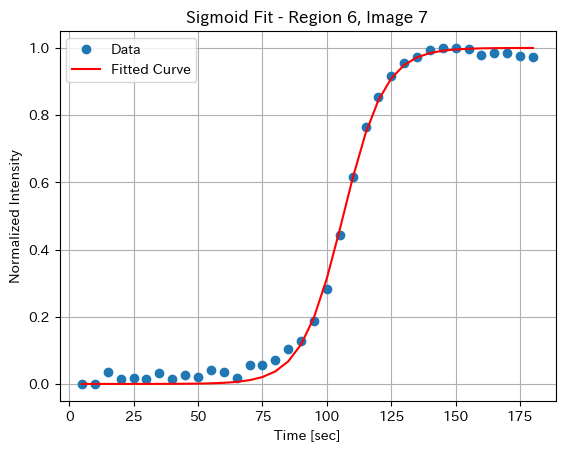

Fitted sigmoid parameters for Region 7, Image 1: [9.74212069e-02 1.02937600e+02]


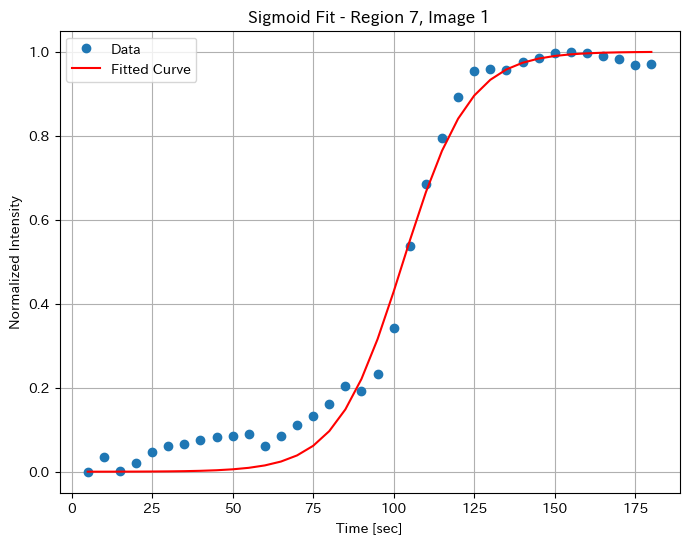

Fitted sigmoid parameters for Region 7, Image 2: [  0.1442086 106.5443766]


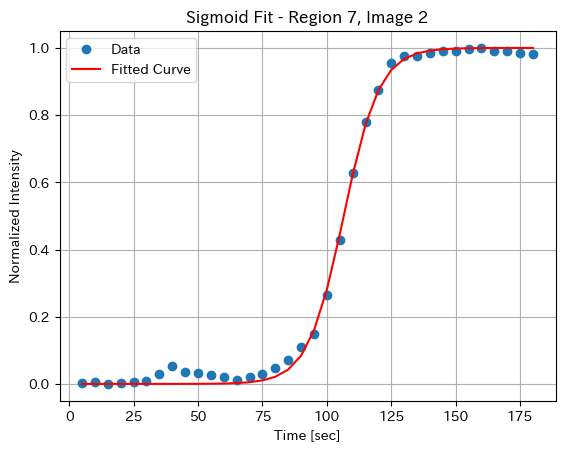

Fitted sigmoid parameters for Region 7, Image 3: [  0.16496834 107.5329401 ]


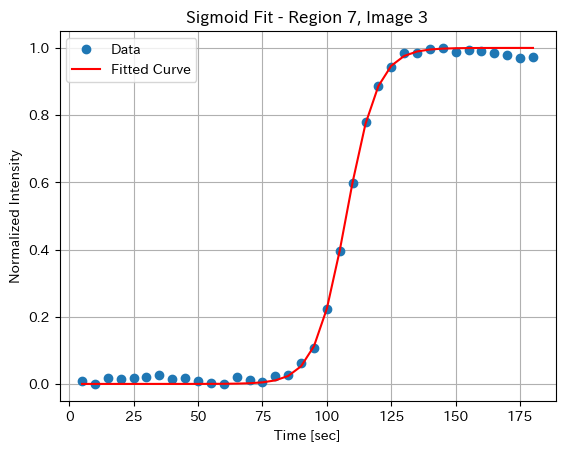

Fitted sigmoid parameters for Region 7, Image 4: [  0.15838891 107.92000456]


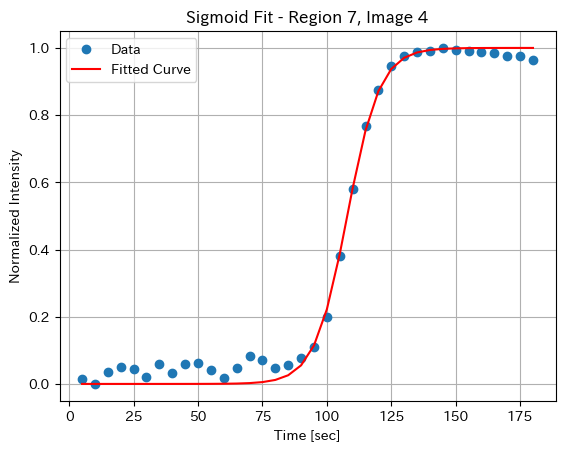

Fitted sigmoid parameters for Region 7, Image 5: [  0.14590275 106.76423133]


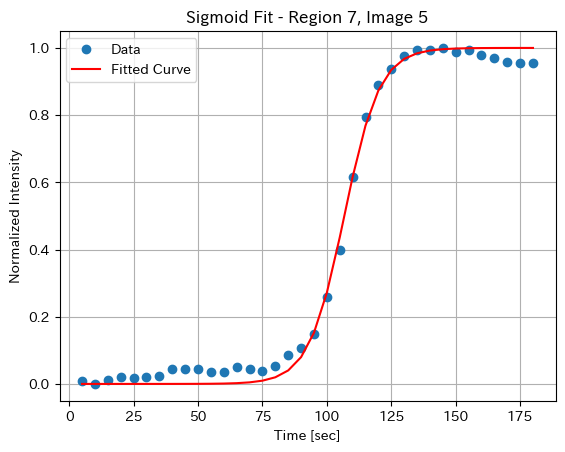

Fitted sigmoid parameters for Region 7, Image 6: [  0.1615107  108.10463236]


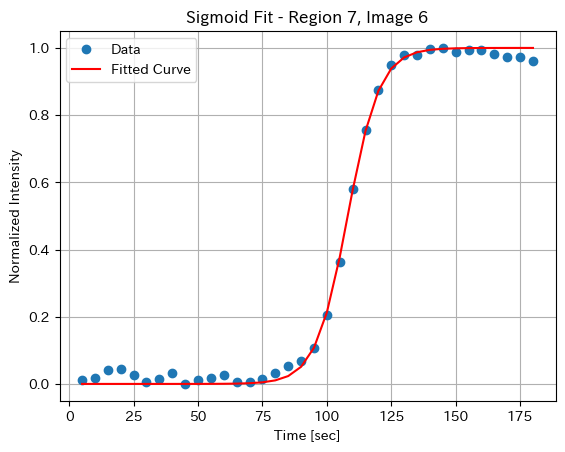

Fitted sigmoid parameters for Region 7, Image 7: [  0.14360424 107.36392386]


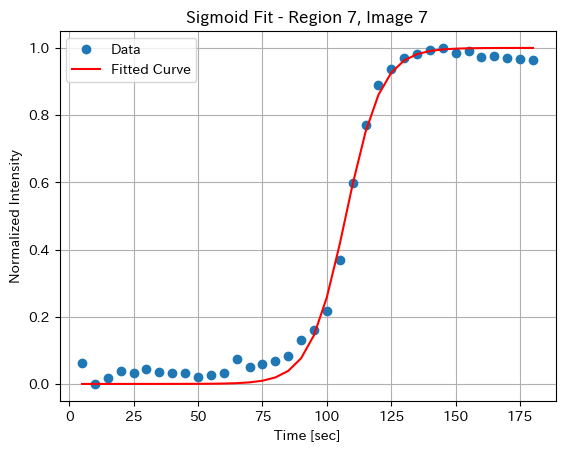

Fitting parameters saved to ./output_data/synthesis_fit\fitting_parameters7_kai.csv


In [13]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.optimize import curve_fit

# シグモイド関数の定義
def sigmoid(x, a, b):
    return 1 / (1 + np.exp(-a * (x - b)))

def fit_sigmoid(x_values, y_values, initial_guess=None):
    if initial_guess is None:
        initial_guess = (0.1, 20)
    
    popt, _ = curve_fit(sigmoid, x_values, y_values, p0=initial_guess)
    return popt

def plot_sigmoid_fit(x_values, y_values, fitted_params, region_num, image_num):
    fitted_curve = sigmoid(x_values, *fitted_params)
    plt.plot(x_values, y_values, 'o', label='Data')
    plt.plot(x_values, fitted_curve, 'r-', label='Fitted Curve')
    plt.xlabel("Time [sec]")  # 横軸を変更
    plt.ylabel("Normalized Intensity")
    plt.title(f"Sigmoid Fit - Region {region_num + 1}, Image {image_num + 1}")
    plt.legend()
    plt.grid(True)
    plt.show()

def save_fitting_parameters_to_csv(filename, fitting_parameters):
    with open(filename, 'w') as file:
        file.write("Region,Image,a,b\n")
        for region_num, region_params in enumerate(fitting_parameters):
            for image_num, (a, b) in enumerate(region_params):
                file.write(f"{region_num + 1},{image_num + 1},{a},{b}\n")
    print(f"Fitting parameters saved to {filename}")

def main(output_folder):
    csv_filename ="./output_data/intensity_data_original7.csv"
    divisions = 7  # 分割数を設定
    x_range = (1, 36)  # 横軸範囲を設定
    
    df = pd.read_csv(csv_filename)
    num_images = len(df)
    
    fitting_parameters = []  # フィッティングパラメータを格納するリスト

    for region_num in range(divisions):
        plt.figure(figsize=(8, 6))

        region_params = []  # 各領域のフィッティングパラメータを格納するリスト

        for i in range(num_images):
            intensities = df.iloc[i, region_num]
            intensities = np.array(eval(intensities))
            
            # 横軸範囲の適用
            if x_range is not None:
                x_range_min, x_range_max = x_range
                intensities = intensities[x_range_min - 1 : x_range_max]  # x_rangeは1から始まるため、-1してインデックスに変換
            
            # 反転正規化
            intensities = intensities * -1
            normalized_intensities = (intensities - np.min(intensities)) / (np.max(intensities) - np.min(intensities))
            
            # シグモイド関数のフィッティング
            x_values = np.arange(x_range_min * 5, x_range_max * 5 + 1, 5)  # 横軸の変更
            fitted_params = fit_sigmoid(x_values, normalized_intensities)
            print(f"Fitted sigmoid parameters for Region {region_num + 1}, Image {i + 1}:", fitted_params)
            
            region_params.append(fitted_params)

            # フィッティング結果をプロット
            plot_sigmoid_fit(x_values, normalized_intensities, fitted_params, region_num, i)
        
        fitting_parameters.append(region_params)

    # フィッティングパラメータをCSVファイルに保存
    parameters_csv_filename = os.path.join(output_folder, "fitting_parameters7_kai.csv")
    save_fitting_parameters_to_csv(parameters_csv_filename, fitting_parameters)

if __name__ == "__main__":
    output_folder = "./output_data/synthesis_fit"
    main(output_folder)


Fitted sigmoid parameters for Region 1, Image 1: [-1.56516305e-01  2.28088721e+02]


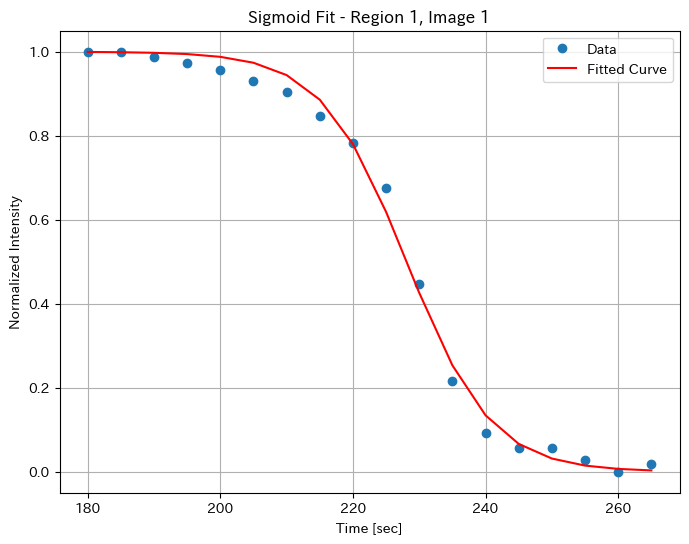

Fitted sigmoid parameters for Region 1, Image 2: [-1.63891111e-01  2.28602658e+02]


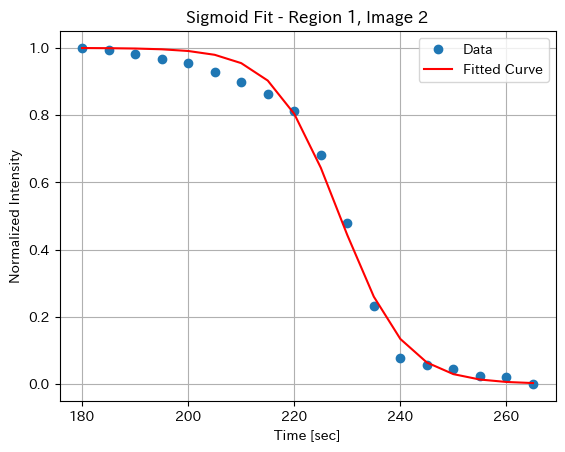

Fitted sigmoid parameters for Region 1, Image 3: [-1.82254145e-01  2.28017060e+02]


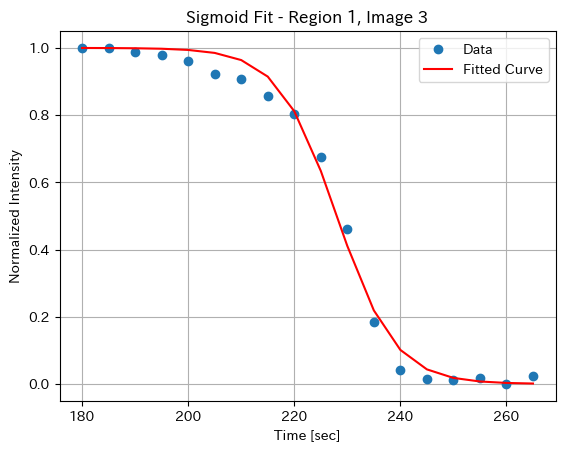

Fitted sigmoid parameters for Region 1, Image 4: [-1.81873392e-01  2.28678013e+02]


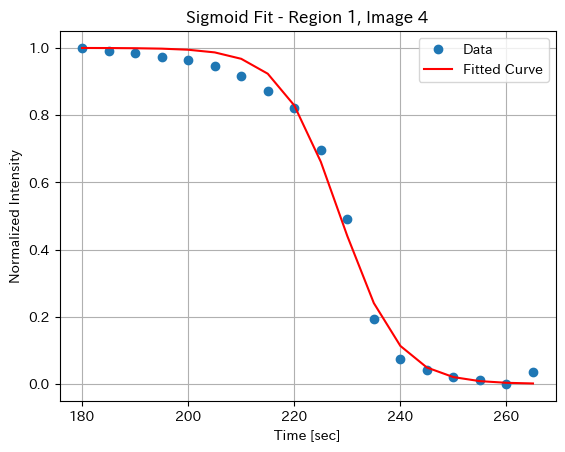

Fitted sigmoid parameters for Region 1, Image 5: [-1.69874421e-01  2.28246207e+02]


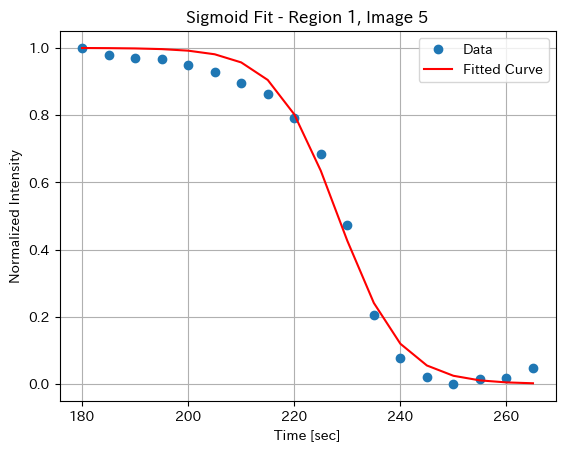

Fitted sigmoid parameters for Region 1, Image 6: [-1.77744182e-01  2.28849714e+02]


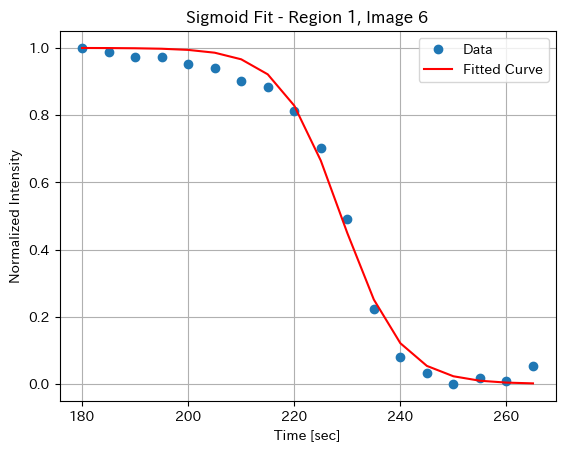

Fitted sigmoid parameters for Region 1, Image 7: [-1.67797889e-01  2.28708104e+02]


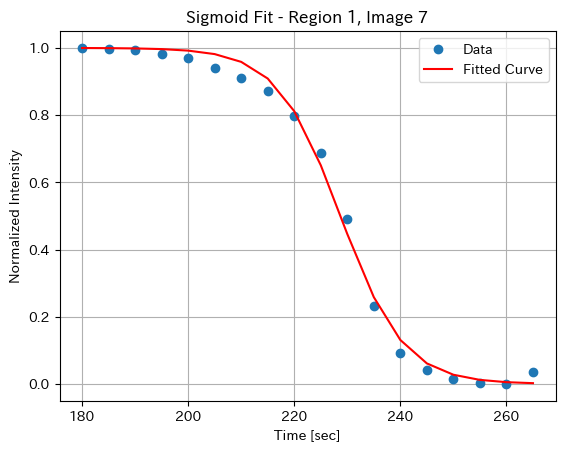

Fitted sigmoid parameters for Region 2, Image 1: [-1.71786577e-01  2.27951453e+02]


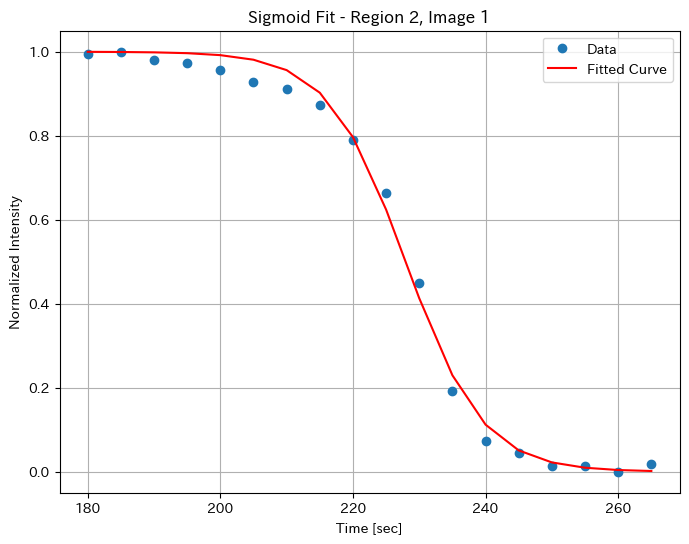

Fitted sigmoid parameters for Region 2, Image 2: [-1.79756112e-01  2.27720071e+02]


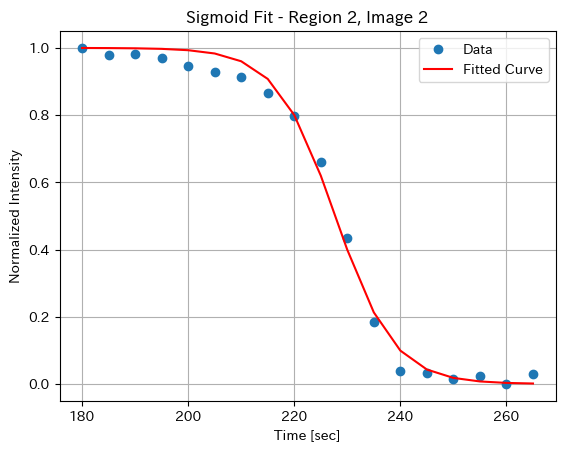

Fitted sigmoid parameters for Region 2, Image 3: [-1.74654867e-01  2.27561121e+02]


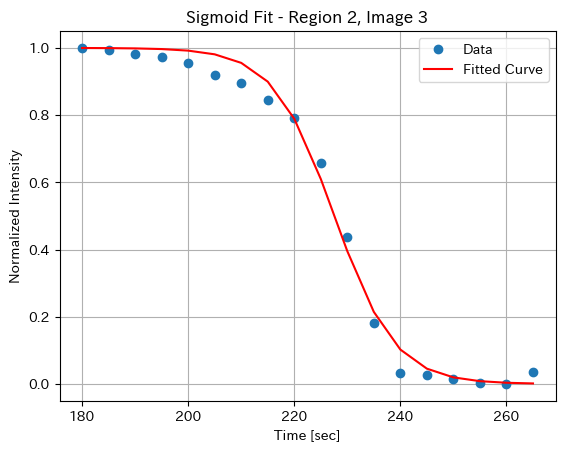

Fitted sigmoid parameters for Region 2, Image 4: [-2.01271253e-01  2.27907585e+02]


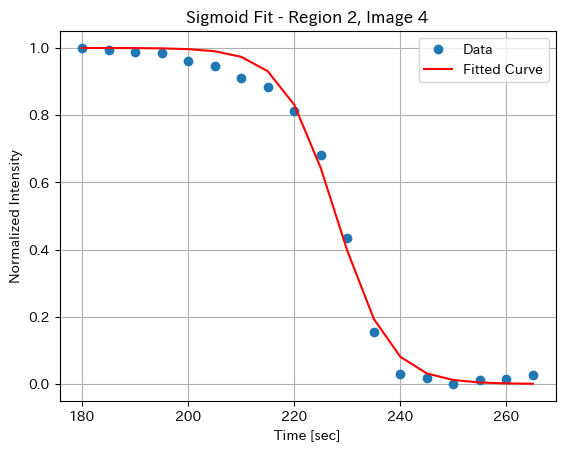

Fitted sigmoid parameters for Region 2, Image 5: [-1.90082742e-01  2.27686289e+02]


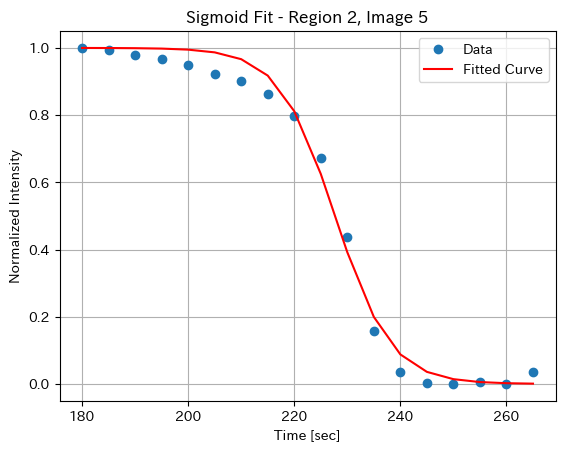

Fitted sigmoid parameters for Region 2, Image 6: [-1.77548597e-01  2.28249741e+02]


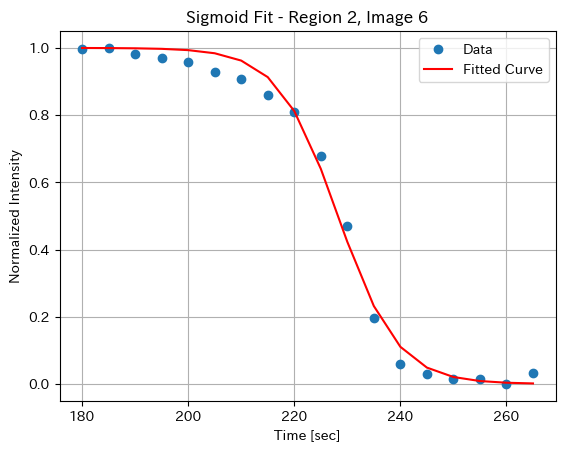

Fitted sigmoid parameters for Region 2, Image 7: [-1.60980213e-01  2.28960688e+02]


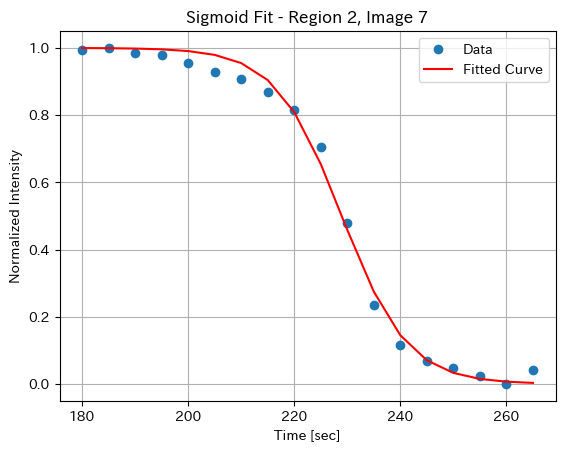

Fitted sigmoid parameters for Region 3, Image 1: [-1.76862650e-01  2.27912314e+02]


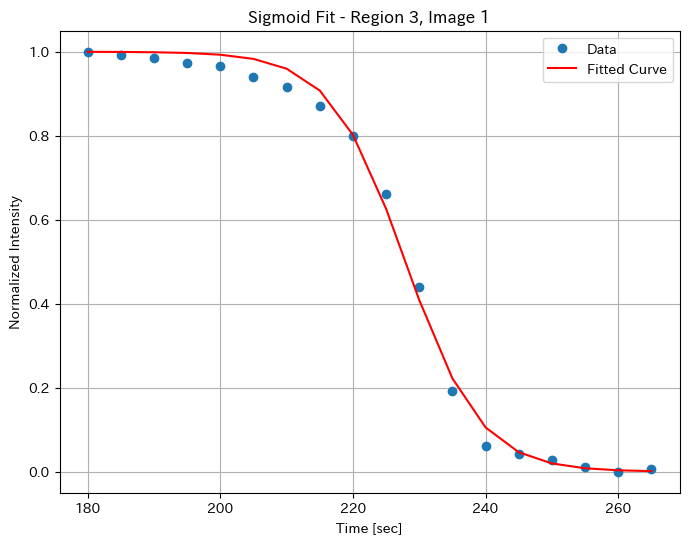

Fitted sigmoid parameters for Region 3, Image 2: [-1.97106447e-01  2.27532516e+02]


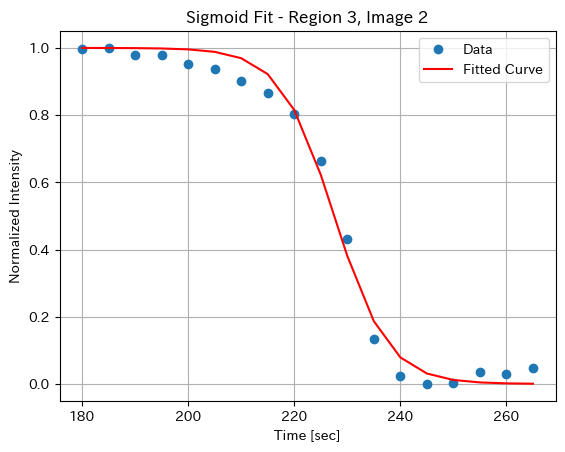

Fitted sigmoid parameters for Region 3, Image 3: [-1.77621098e-01  2.28199182e+02]


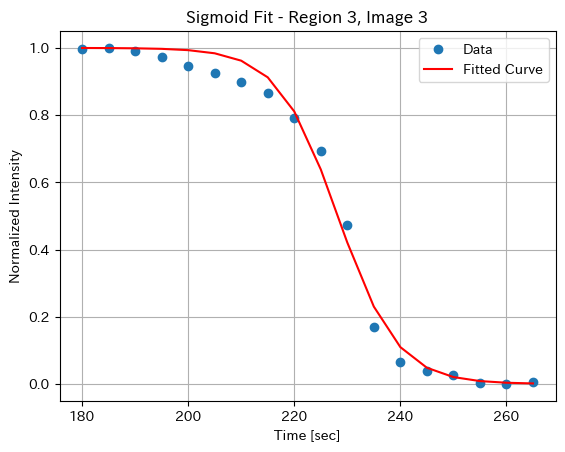

Fitted sigmoid parameters for Region 3, Image 4: [-1.94469788e-01  2.27683953e+02]


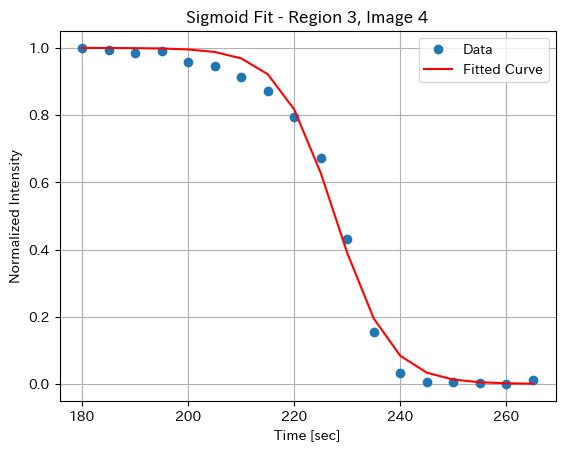

Fitted sigmoid parameters for Region 3, Image 5: [-1.88038952e-01  2.27601635e+02]


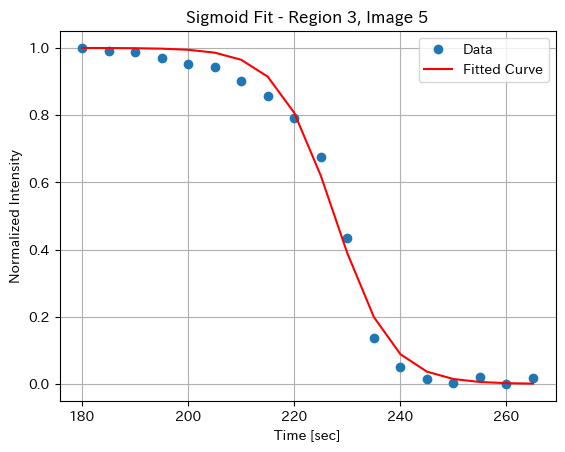

Fitted sigmoid parameters for Region 3, Image 6: [-1.90496774e-01  2.28078651e+02]


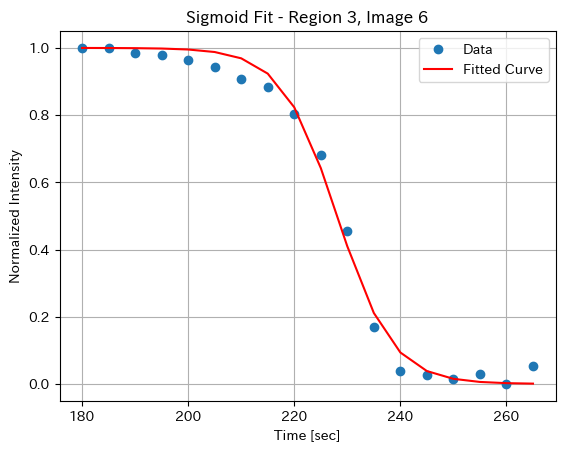

Fitted sigmoid parameters for Region 3, Image 7: [-1.47114089e-01  2.29231128e+02]


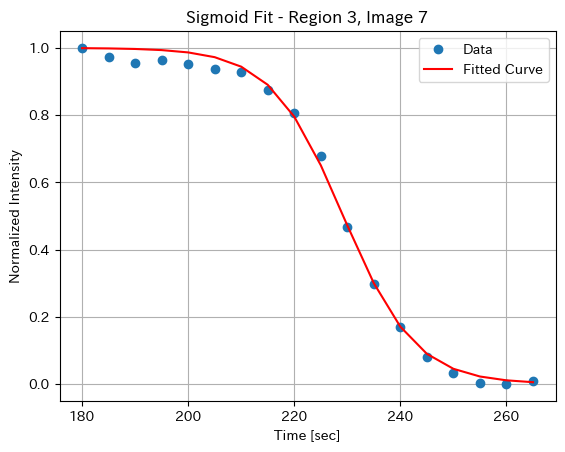

Fitted sigmoid parameters for Region 4, Image 1: [-1.72293810e-01  2.28315319e+02]


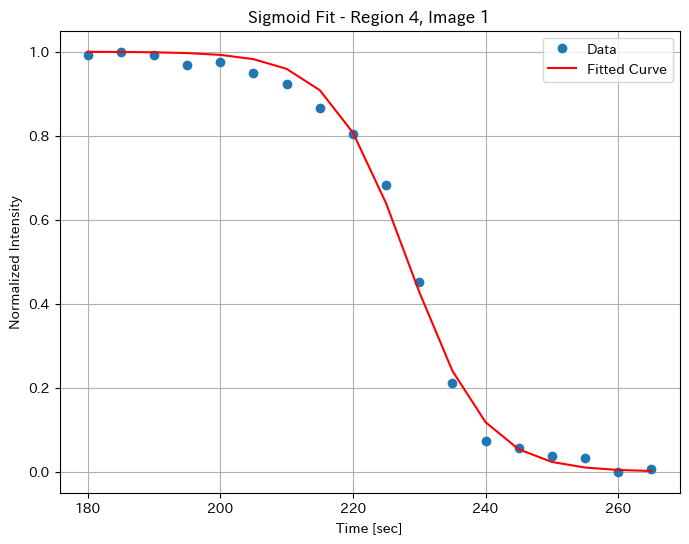

Fitted sigmoid parameters for Region 4, Image 2: [-1.94877487e-01  2.27508040e+02]


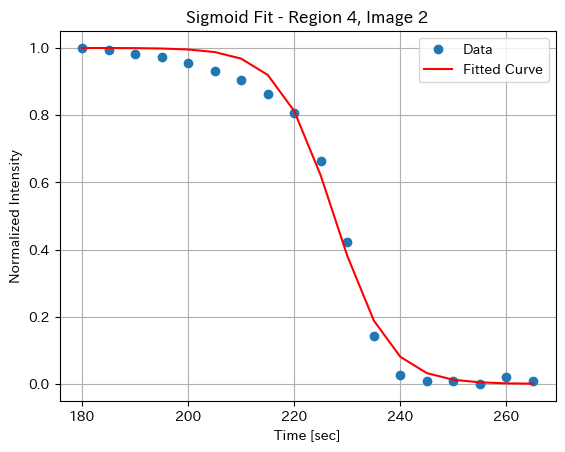

Fitted sigmoid parameters for Region 4, Image 3: [-2.13031666e-01  2.27750952e+02]


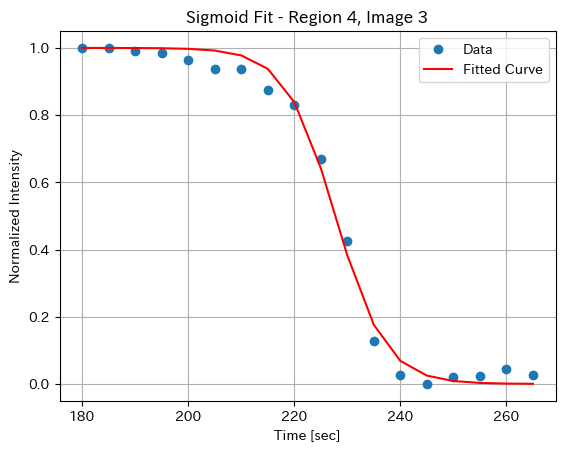

Fitted sigmoid parameters for Region 4, Image 4: [-1.92766184e-01  2.28065103e+02]


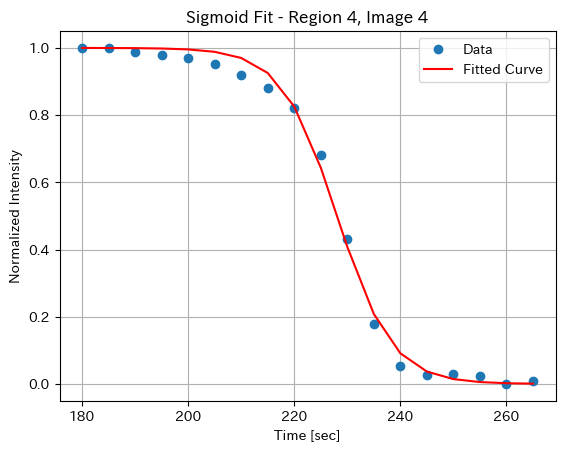

Fitted sigmoid parameters for Region 4, Image 5: [-2.11122912e-01  2.27630663e+02]


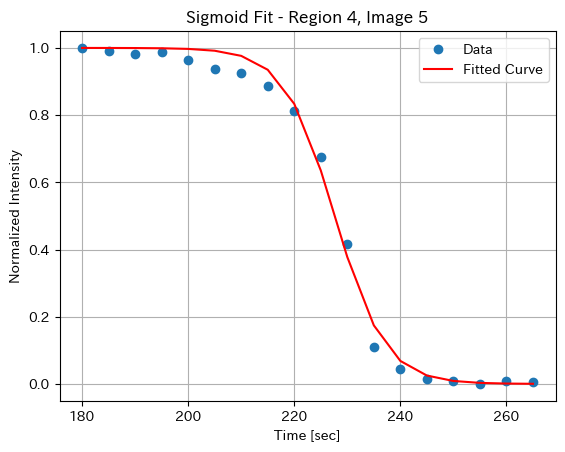

Fitted sigmoid parameters for Region 4, Image 6: [-1.84086207e-01  2.27512007e+02]


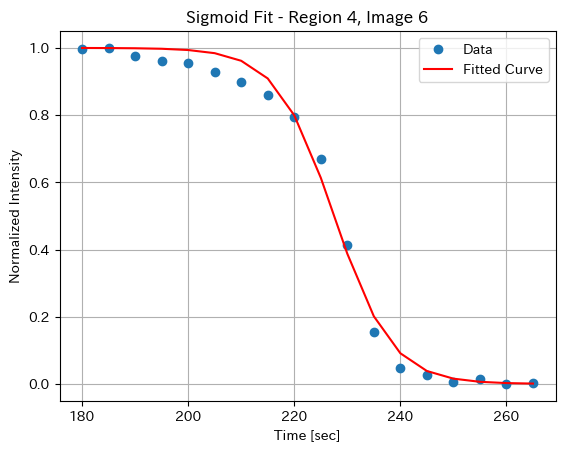

Fitted sigmoid parameters for Region 4, Image 7: [-1.62889277e-01  2.28437122e+02]


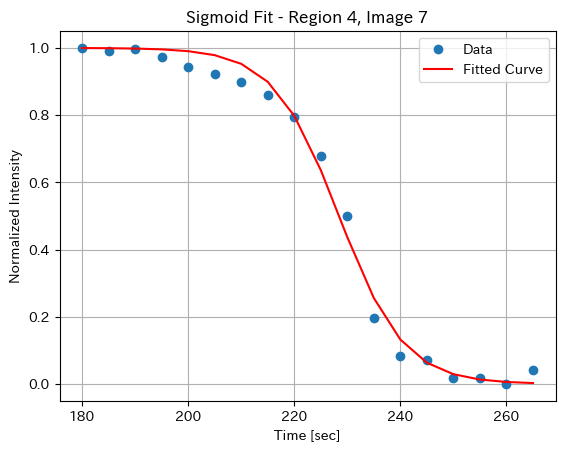

Fitted sigmoid parameters for Region 5, Image 1: [-1.84829099e-01  2.26528467e+02]


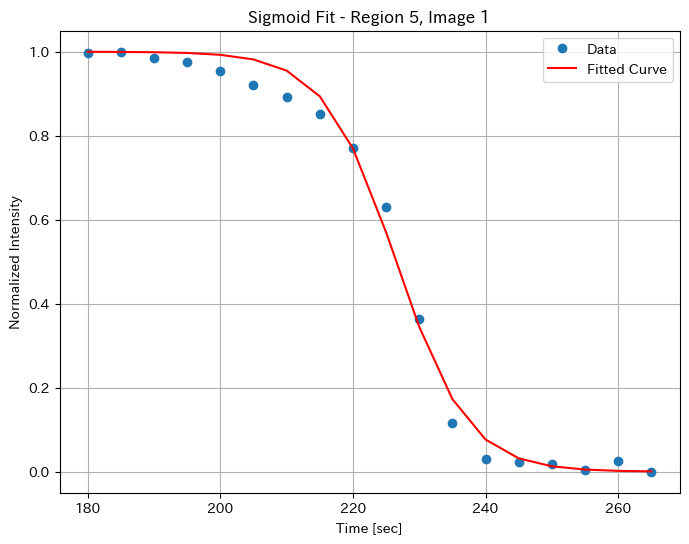

Fitted sigmoid parameters for Region 5, Image 2: [-1.94583089e-01  2.27743530e+02]


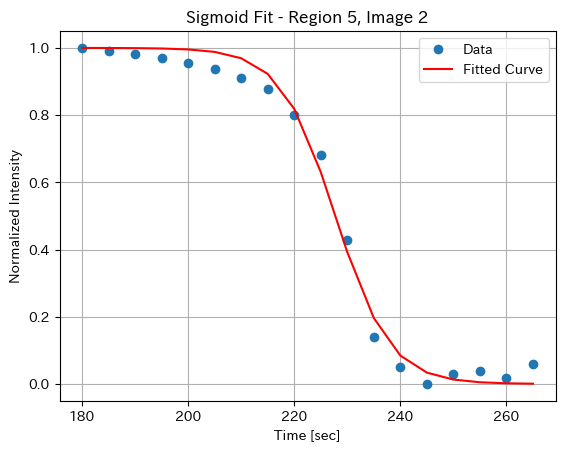

Fitted sigmoid parameters for Region 5, Image 3: [-2.2139278e-01  2.2763274e+02]


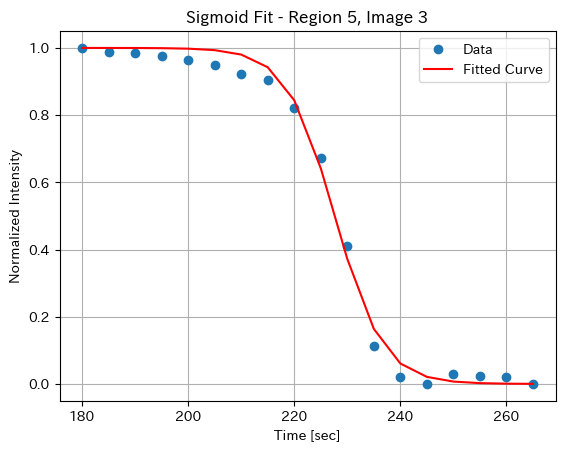

Fitted sigmoid parameters for Region 5, Image 4: [-1.97671792e-01  2.27018735e+02]


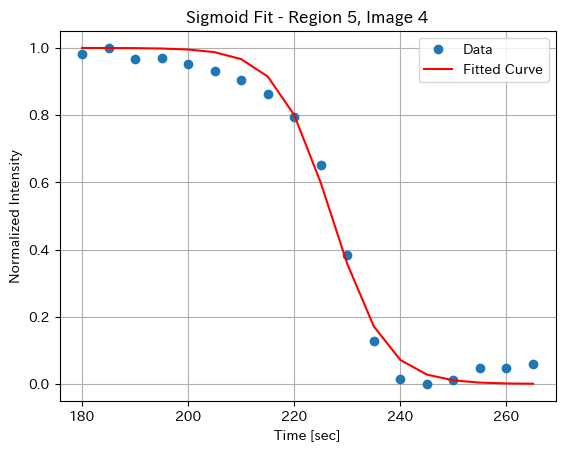

Fitted sigmoid parameters for Region 5, Image 5: [-1.91749470e-01  2.26980505e+02]


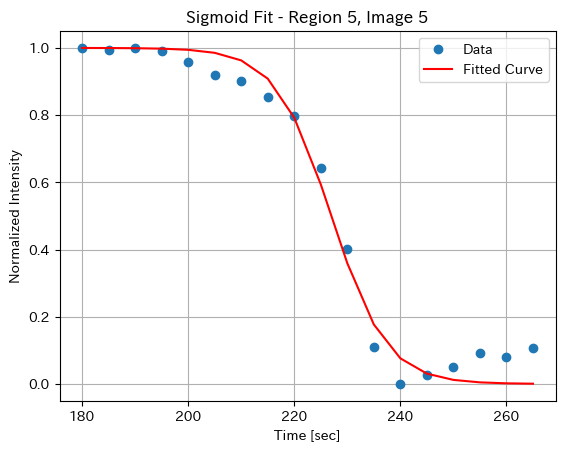

Fitted sigmoid parameters for Region 5, Image 6: [-1.99887182e-01  2.27017930e+02]


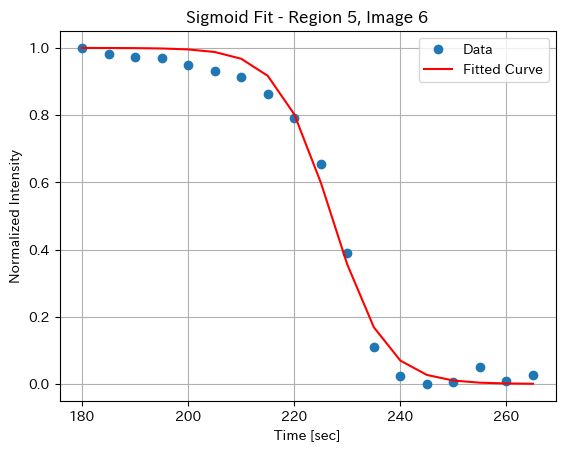

Fitted sigmoid parameters for Region 5, Image 7: [-1.91872166e-01  2.26997398e+02]


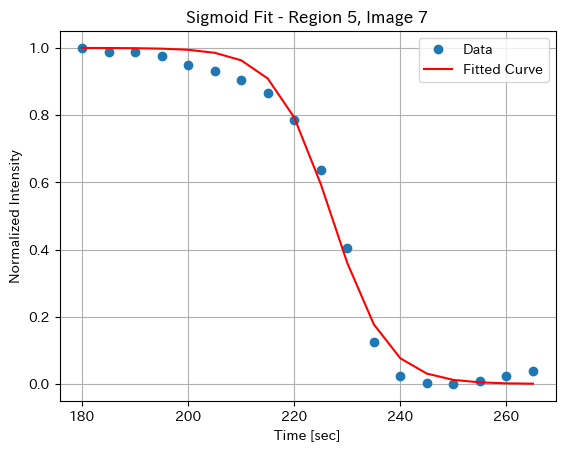

Fitted sigmoid parameters for Region 6, Image 1: [-1.54236612e-01  2.28856764e+02]


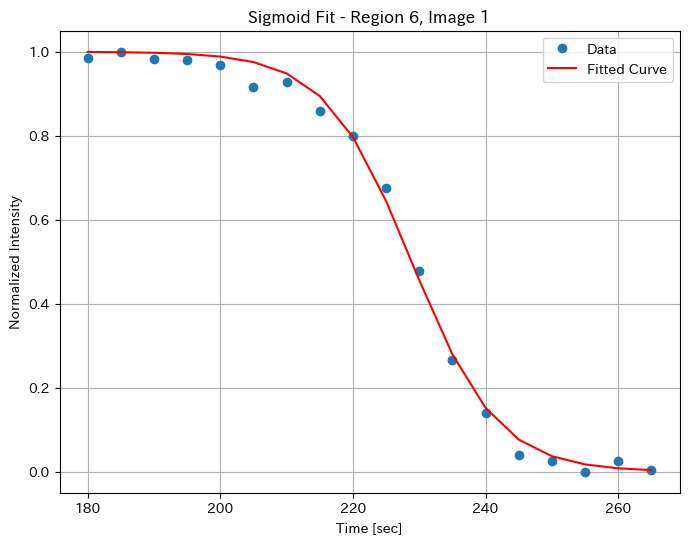

Fitted sigmoid parameters for Region 6, Image 2: [-1.76350110e-01  2.27199601e+02]


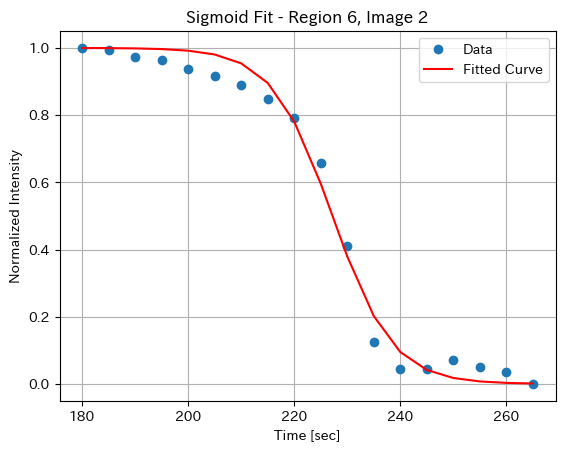

Fitted sigmoid parameters for Region 6, Image 3: [-2.05754053e-01  2.27217634e+02]


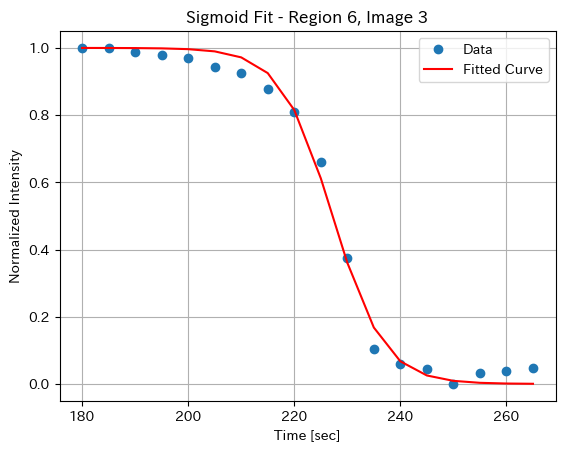

Fitted sigmoid parameters for Region 6, Image 4: [-2.13628448e-01  2.26672208e+02]


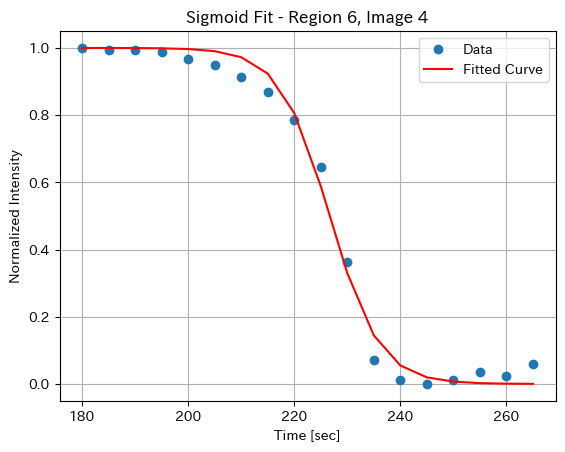

Fitted sigmoid parameters for Region 6, Image 5: [-2.10649751e-01  2.27183731e+02]


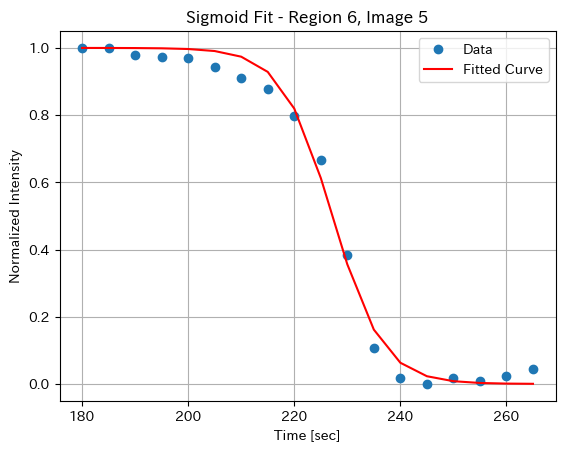

Fitted sigmoid parameters for Region 6, Image 6: [-1.89968849e-01  2.26850492e+02]


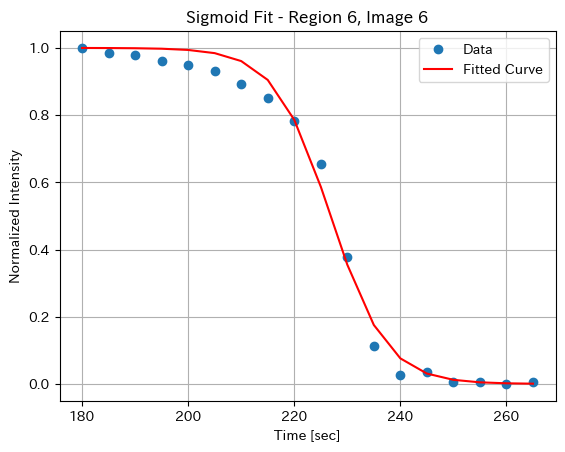

Fitted sigmoid parameters for Region 6, Image 7: [-2.03458000e-01  2.27219054e+02]


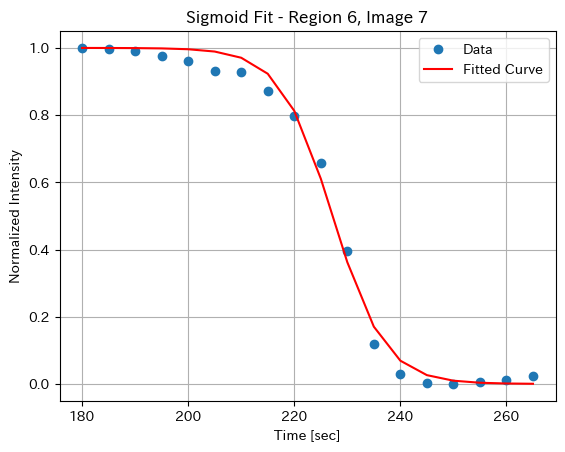

Fitted sigmoid parameters for Region 7, Image 1: [-1.27726303e-01  2.28166421e+02]


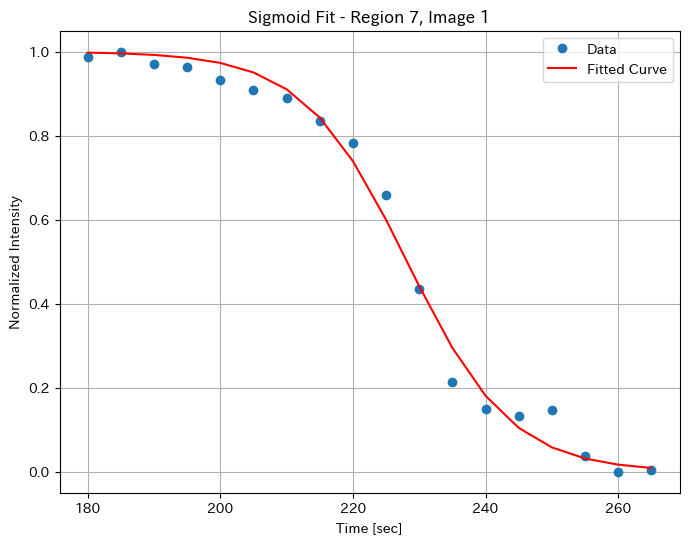

Fitted sigmoid parameters for Region 7, Image 2: [-1.80271903e-01  2.26486813e+02]


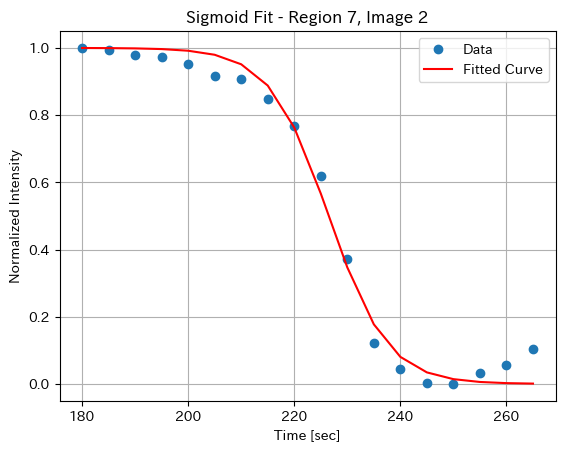

Fitted sigmoid parameters for Region 7, Image 3: [-2.07946783e-01  2.26771987e+02]


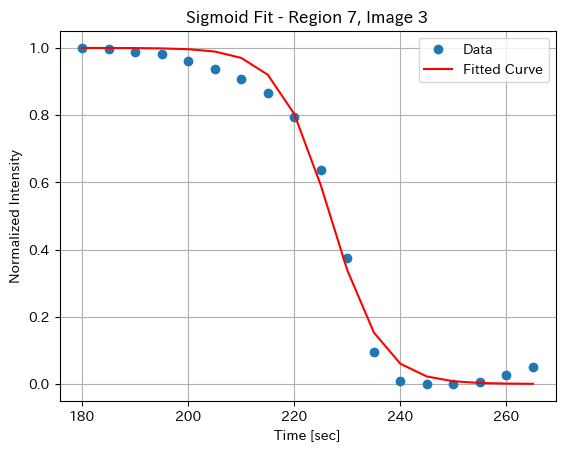

Fitted sigmoid parameters for Region 7, Image 4: [-2.07409526e-01  2.26485707e+02]


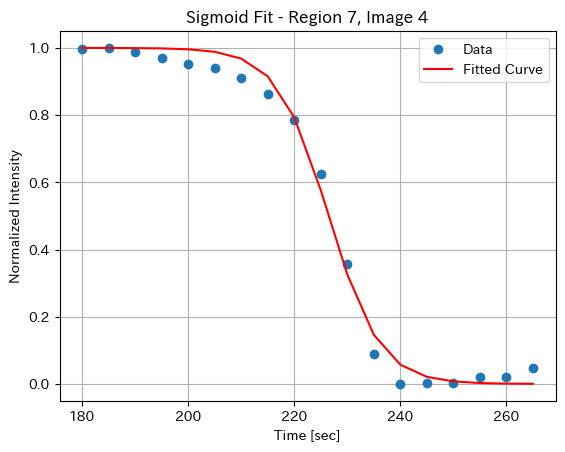

Fitted sigmoid parameters for Region 7, Image 5: [-1.99937143e-01  2.26548595e+02]


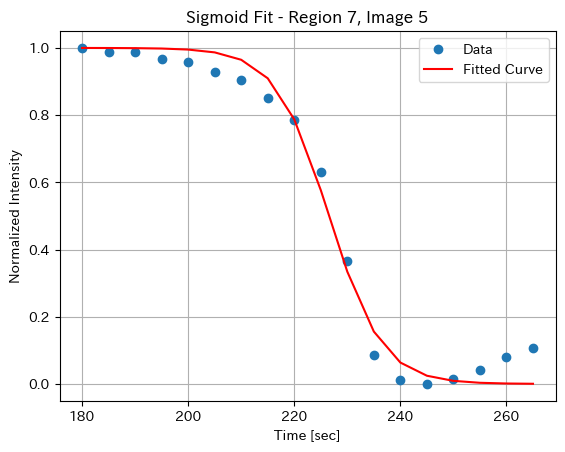

Fitted sigmoid parameters for Region 7, Image 6: [-1.97041066e-01  2.26760787e+02]


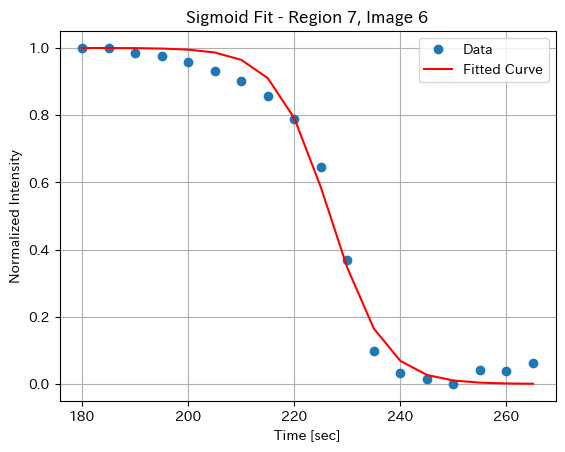

Fitted sigmoid parameters for Region 7, Image 7: [-2.14637314e-01  2.26615440e+02]


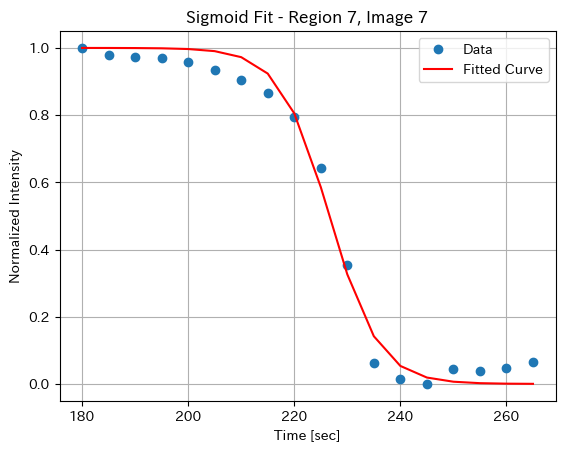

Fitting parameters saved to ./output_data/release_fit\fitting_parameters7_kai.csv


In [14]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.optimize import curve_fit

# シグモイド関数の定義
def sigmoid(x, a, b):
    return 1 / (1 + np.exp(-a * (x - b)))

def fit_sigmoid(x_values, y_values, initial_guess=None):
    if initial_guess is None:
        initial_guess = (-0.1, 220)
    
    popt, _ = curve_fit(sigmoid, x_values, y_values, p0=initial_guess)
    return popt

def plot_sigmoid_fit(x_values, y_values, fitted_params, region_num, image_num):
    fitted_curve = sigmoid(x_values, *fitted_params)
    plt.plot(x_values, y_values, 'o', label='Data')
    plt.plot(x_values, fitted_curve, 'r-', label='Fitted Curve')
    plt.xlabel("Time [sec]")  # 横軸を変更
    plt.ylabel("Normalized Intensity")
    plt.title(f"Sigmoid Fit - Region {region_num + 1}, Image {image_num + 1}")
    plt.legend()
    plt.grid(True)
    plt.show()

def save_fitting_parameters_to_csv(filename, fitting_parameters):
    with open(filename, 'w') as file:
        file.write("Region,Image,a,b\n")
        for region_num, region_params in enumerate(fitting_parameters):
            for image_num, (a, b) in enumerate(region_params):
                file.write(f"{region_num + 1},{image_num + 1},{a},{b}\n")
    print(f"Fitting parameters saved to {filename}")

def main(output_folder):
    csv_filename ="./output_data/intensity_data_original7.csv"
    divisions = 7  # 分割数を設定
    x_range = (36, 53)  # 横軸範囲を設定
    
    df = pd.read_csv(csv_filename)
    num_images = len(df)
    
    fitting_parameters = []  # フィッティングパラメータを格納するリスト

    for region_num in range(divisions):
        plt.figure(figsize=(8, 6))

        region_params = []  # 各領域のフィッティングパラメータを格納するリスト

        for i in range(num_images):
            intensities = df.iloc[i, region_num]
            intensities = np.array(eval(intensities))
            
            # 横軸範囲の適用
            if x_range is not None:
                x_range_min, x_range_max = x_range
                intensities = intensities[x_range_min - 1 : x_range_max]  # x_rangeは1から始まるため、-1してインデックスに変換
            
            # 反転正規化
            intensities = intensities * -1
            normalized_intensities = (intensities - np.min(intensities)) / (np.max(intensities) - np.min(intensities))
            
            # シグモイド関数のフィッティング
            x_values = np.arange(x_range_min * 5, x_range_max * 5 + 1, 5)  # 横軸の変更
            fitted_params = fit_sigmoid(x_values, normalized_intensities)
            print(f"Fitted sigmoid parameters for Region {region_num + 1}, Image {i + 1}:", fitted_params)
            
            region_params.append(fitted_params)

            # フィッティング結果をプロット
            plot_sigmoid_fit(x_values, normalized_intensities, fitted_params, region_num, i)
        
        fitting_parameters.append(region_params)

    # フィッティングパラメータをCSVファイルに保存
    parameters_csv_filename = os.path.join(output_folder, "fitting_parameters7_kai.csv")
    save_fitting_parameters_to_csv(parameters_csv_filename, fitting_parameters)

if __name__ == "__main__":
    output_folder = "./output_data/release_fit"
    main(output_folder)


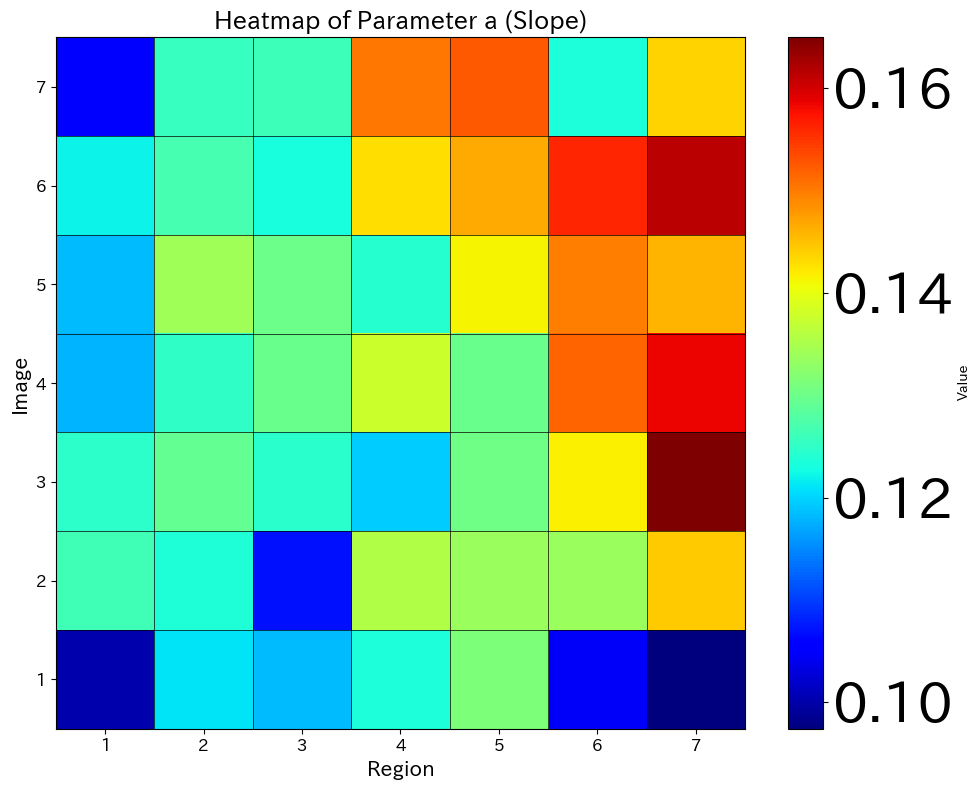

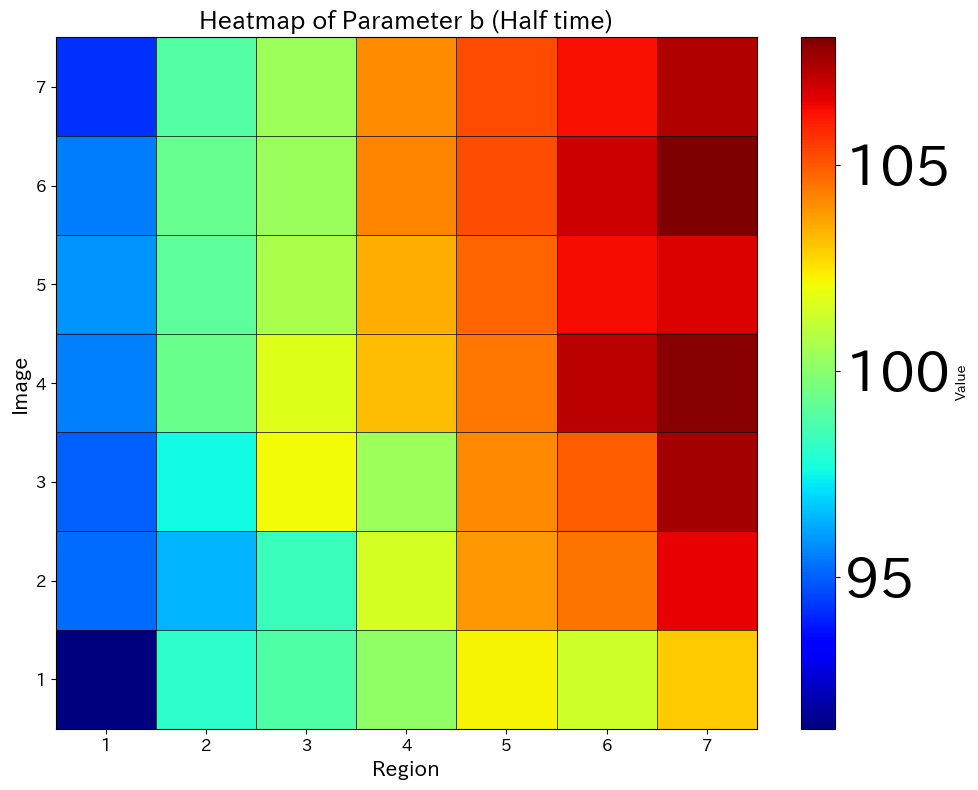

In [15]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

def plot_heatmap(data, title):
    plt.figure(figsize=(10, 8))  # グラフのサイズを調整
    im = plt.imshow(data, cmap='jet', interpolation='nearest', aspect='auto')  # 赤と青のカラーマップ

    # カラーバーの設定
    cbar = plt.colorbar(im, label='Value')
    cbar.ax.tick_params(labelsize=40)  # カラーバー目盛りのフォントサイズを調整
    cbar.ax.locator_params(nbins=5)    # カラーバーの目盛りの数を設定

    # タイトルと軸ラベルの設定
    plt.title(title, fontsize=18)
    plt.xlabel('Region', fontsize=15)
    plt.ylabel('Image', fontsize=15)

    # 軸ラベルの設定
    plt.xticks(np.arange(7), np.arange(1, 8), fontsize=12)  # x軸目盛りのフォントサイズを調整
    plt.yticks(np.arange(7), np.arange(7, 0, -1), fontsize=12)  # y軸目盛りのフォントサイズを調整

    # 黒枠を追加
    plt.gca().set_xticks(np.arange(-0.5, 7, 1), minor=True)
    plt.gca().set_yticks(np.arange(-0.5, 7, 1), minor=True)
    plt.grid(which="minor", color="black", linestyle='-', linewidth=0.5)
    plt.tick_params(which="minor", size=0)  # マイナーグリッドの目盛りを隠す

    # レイアウト調整
    plt.tight_layout()
    plt.show()

def main():
    fitting_results_filename = "./output_data/synthesis_fit/fitting_parameters7_kai.csv"
    
    # CSVファイルの読み込み
    fitting_results = pd.read_csv(fitting_results_filename)
    fitting_results = fitting_results.pivot(index='Image', columns='Region')
    
    # a, b の値を取得
    a_values = fitting_results['a'].values
    b_values = fitting_results['b'].values
    
    # データの並び順を逆にする
    a_values = np.flipud(a_values)
    b_values = np.flipud(b_values)
    
    # ヒートマップをプロット
    plot_heatmap(a_values, 'Heatmap of Parameter a (Slope)')
    plot_heatmap(b_values, 'Heatmap of Parameter b (Half time)')

if __name__ == "__main__":
    main()


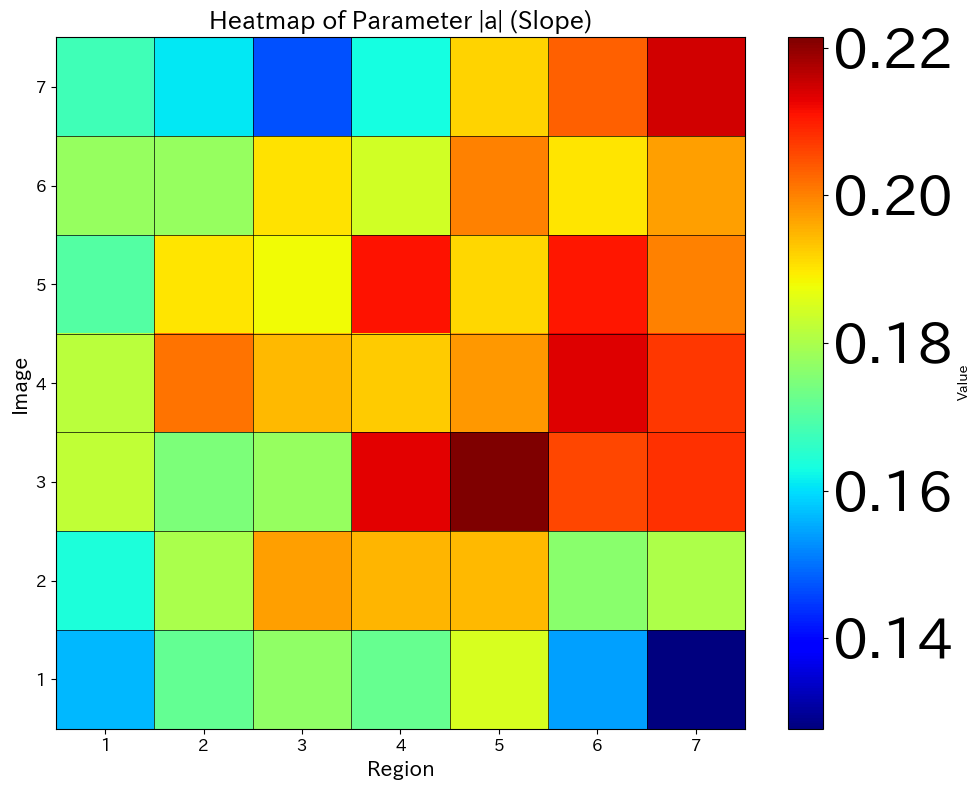

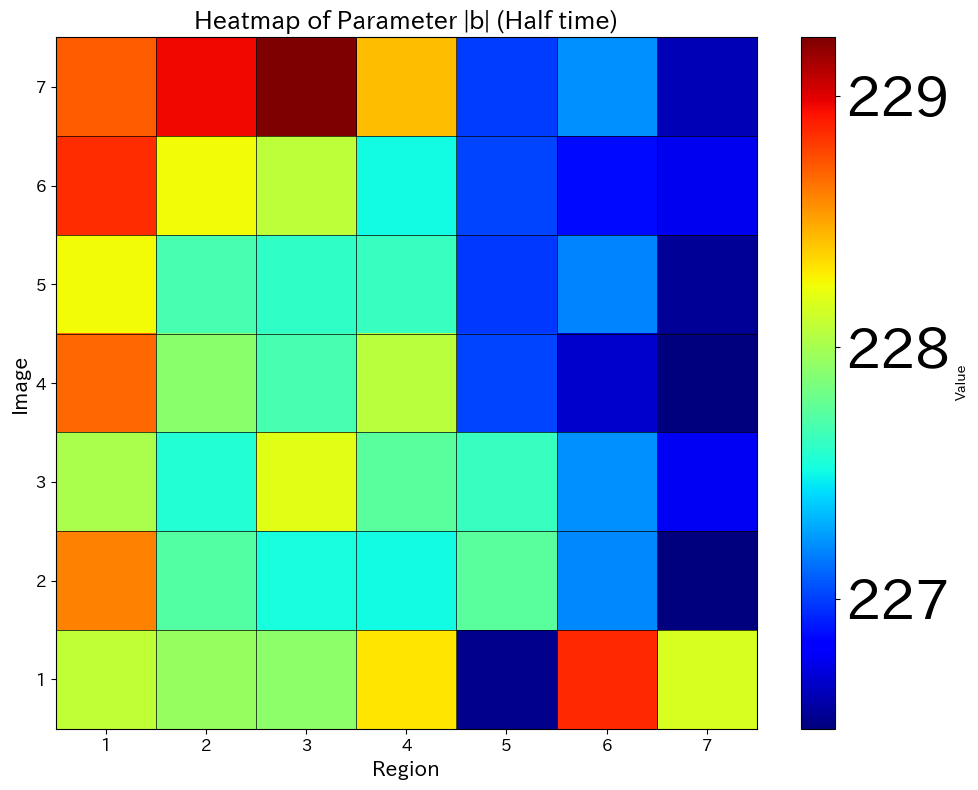

In [16]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

def plot_heatmap(data, title):
    plt.figure(figsize=(10, 8))  # グラフのサイズを調整
    im = plt.imshow(data, cmap='jet', interpolation='nearest', aspect='auto')  # 赤と青のカラーマップ

    # カラーバーの設定
    cbar = plt.colorbar(im, label='Value')
    cbar.ax.tick_params(labelsize=40)  # カラーバー目盛りのフォントサイズを調整
    cbar.ax.locator_params(nbins=5)    # カラーバーの目盛りの数を設定

    # タイトルと軸ラベルの設定
    plt.title(title, fontsize=18)
    plt.xlabel('Region', fontsize=15)
    plt.ylabel('Image', fontsize=15)

    # 軸ラベルの設定
    plt.xticks(np.arange(7), np.arange(1, 8), fontsize=12)  # x軸目盛りのフォントサイズを調整
    plt.yticks(np.arange(7), np.arange(7, 0, -1), fontsize=12)  # y軸目盛りのフォントサイズを調整

    # 黒枠を追加
    plt.gca().set_xticks(np.arange(-0.5, 7, 1), minor=True)
    plt.gca().set_yticks(np.arange(-0.5, 7, 1), minor=True)
    plt.grid(which="minor", color="black", linestyle='-', linewidth=0.5)
    plt.tick_params(which="minor", size=0)  # マイナーグリッドの目盛りを隠す

    # レイアウト調整
    plt.tight_layout()
    plt.show()

def main():
    fitting_results_filename = "./output_data/release_fit/fitting_parameters7_kai.csv"
    
    # CSVファイルの読み込み
    fitting_results = pd.read_csv(fitting_results_filename)
    fitting_results = fitting_results.pivot(index='Image', columns='Region')
    
    # a, b の値を取得し、絶対値に変換
    a_values = np.abs(fitting_results['a'].values)
    b_values = np.abs(fitting_results['b'].values)
    
    # データの並び順を逆にする
    a_values = np.flipud(a_values)
    b_values = np.flipud(b_values)
    
    # ヒートマップをプロット
    plot_heatmap(a_values, 'Heatmap of Parameter |a| (Slope)')
    plot_heatmap(b_values, 'Heatmap of Parameter |b| (Half time)')

if __name__ == "__main__":
    main()
